In [3]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

[master db2e4fff] From Mac
 6 files changed, 13728 insertions(+), 2278 deletions(-)
 delete mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/4. Norm G Tanh-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/4. Norm G aTan-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/5. add discrim . ipynb-checkpoint.ipynb
 delete mode 100644 NeuralNetwork/AAE/4. Norm G Tanh.ipynb
 create mode 100644 NeuralNetwork/AAE/4. Norm G aTan.ipynb
 create mode 100644 NeuralNetwork/AAE/5. add discrim . ipynb.ipynb
^C


In [1]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [2]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


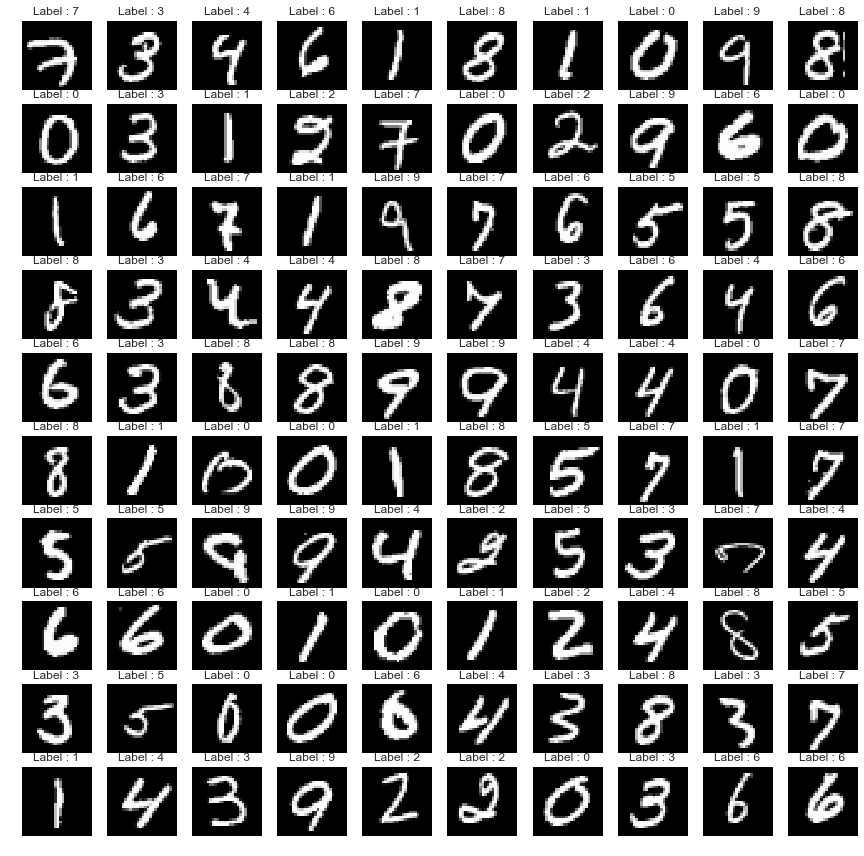

In [3]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [71]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [72]:
# hyper class
num_epoch = 101; batch_size = 100; print_size = 1; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

def norm_vec(x):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (0.00005 + 0.00005) - 0.00005

In [73]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [74]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [75]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [76]:
# 3. update the generator 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(norm_vec(fake_disgrad1)+fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(norm_vec(fake_egrad3)+fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(norm_vec(fake_egrad2)+fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

 iter: 0 batch: 19900 recon    cost: 0.22855163 dis one  cost: 0.0011339979								 dis zero cost: 0.00079914054 fake     cost: 13.0084994

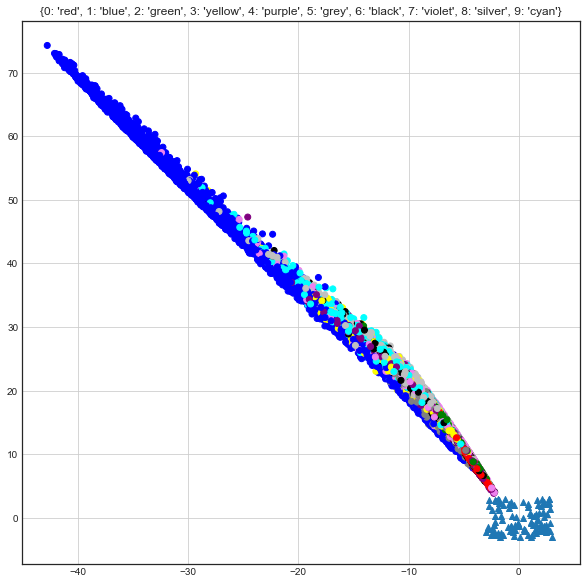

 iter: 1 batch: 19900 recon    cost: 0.21662934 dis one  cost: 0.22080427								 dis zero cost: 0.41442004 fake     cost: 3.92524395555

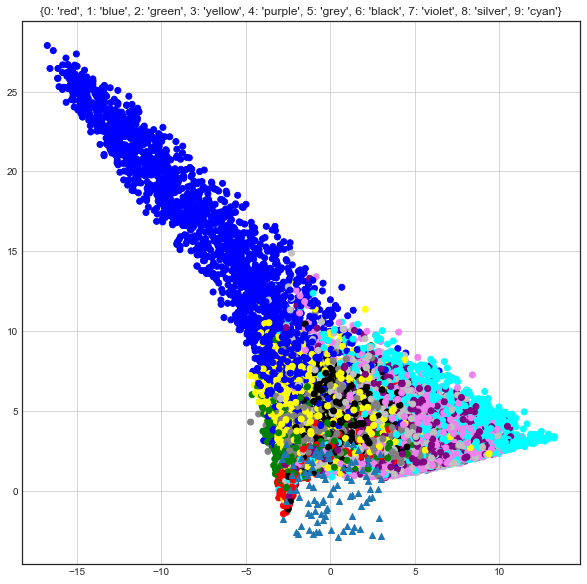

 iter: 2 batch: 19900 recon    cost: 0.19686069 dis one  cost: 0.4713759								 dis zero cost: 0.5190644 fake     cost: 1.904998748

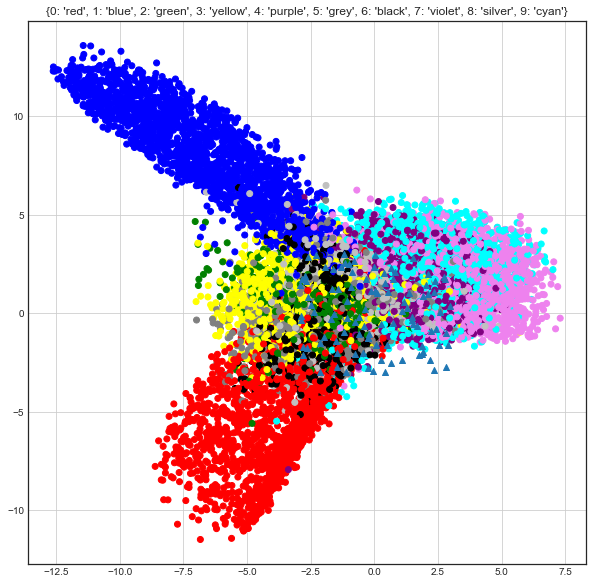

 iter: 3 batch: 19900 recon    cost: 0.1905232 dis one  cost: 0.54167736								 dis zero cost: 0.5422921 fake     cost: 1.699022568

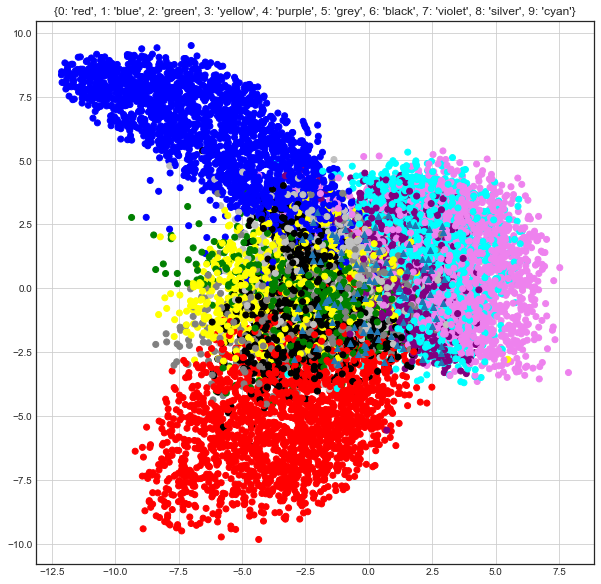

 iter: 4 batch: 19900 recon    cost: 0.1870146 dis one  cost: 0.5339223								 dis zero cost: 0.56400675 fake     cost: 1.806287593

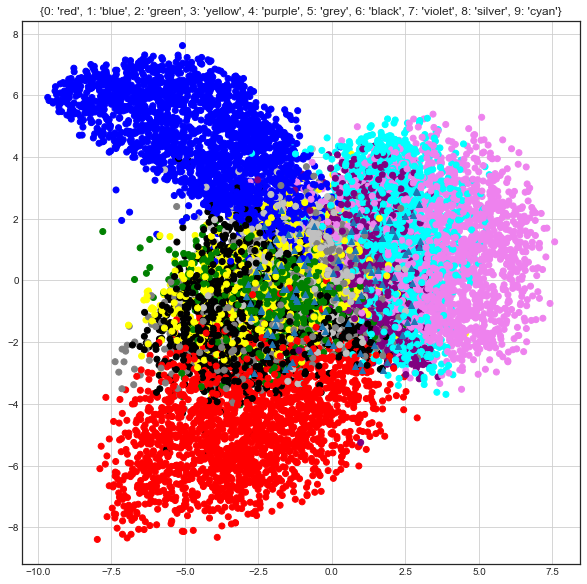

 iter: 5 batch: 19900 recon    cost: 0.18453026 dis one  cost: 0.55899084								 dis zero cost: 0.5264024 fake     cost: 1.71117717

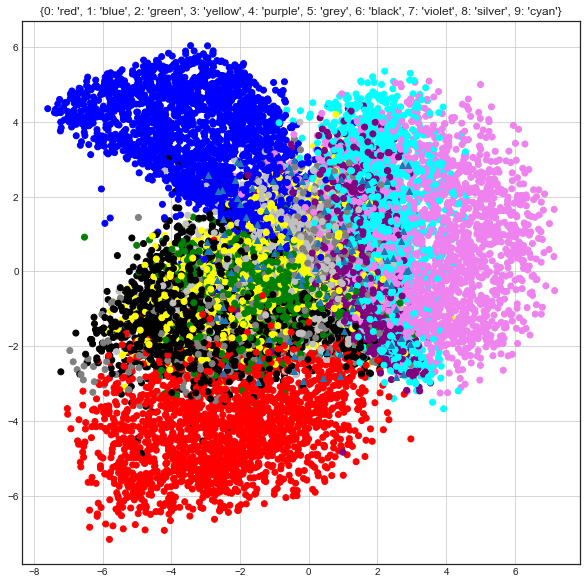

 iter: 6 batch: 19900 recon    cost: 0.18275264 dis one  cost: 0.58105826								 dis zero cost: 0.512202 fake     cost: 1.698088611

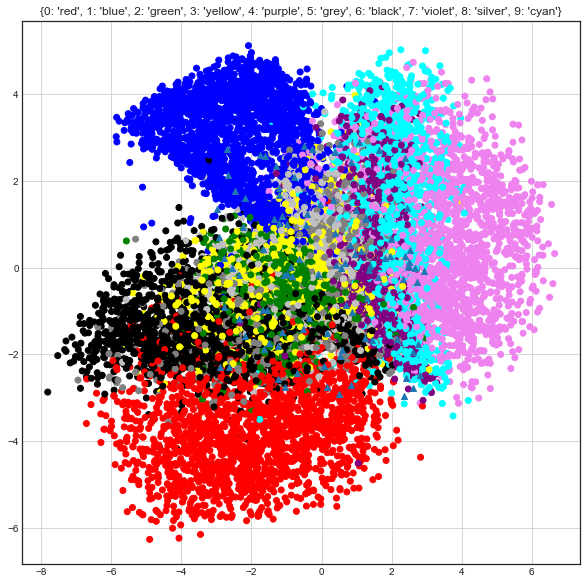

 iter: 7 batch: 19900 recon    cost: 0.18144406 dis one  cost: 0.6299941								 dis zero cost: 0.49625182 fake     cost: 1.67611589

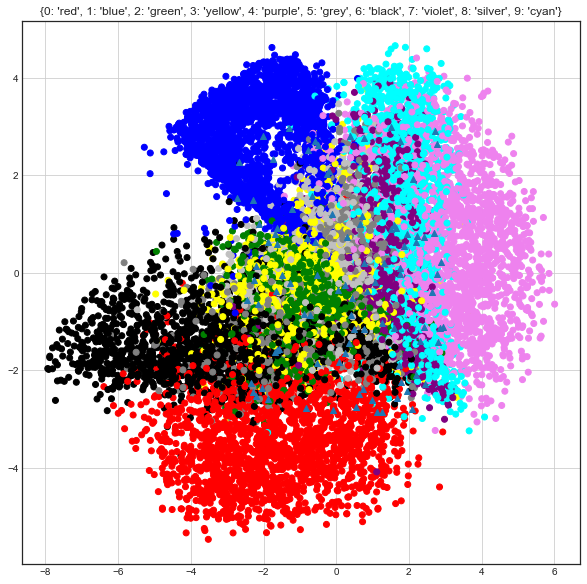

 iter: 8 batch: 19900 recon    cost: 0.18024231 dis one  cost: 0.62334937								 dis zero cost: 0.48772085 fake     cost: 1.5461696

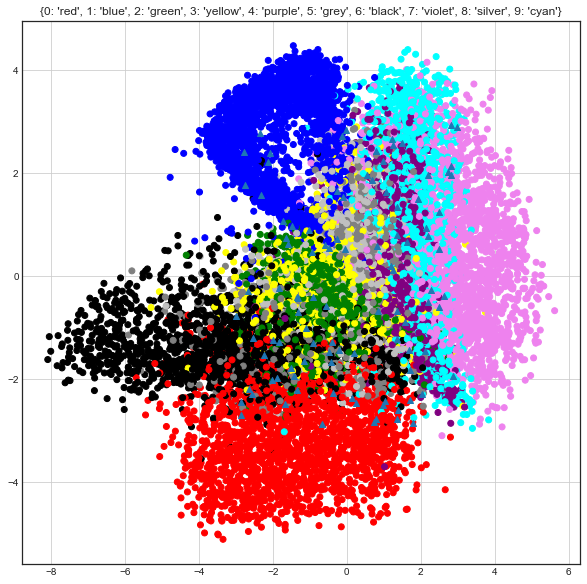

 iter: 9 batch: 19900 recon    cost: 0.17911598 dis one  cost: 0.62921655								 dis zero cost: 0.5819678 fake     cost: 1.41127385

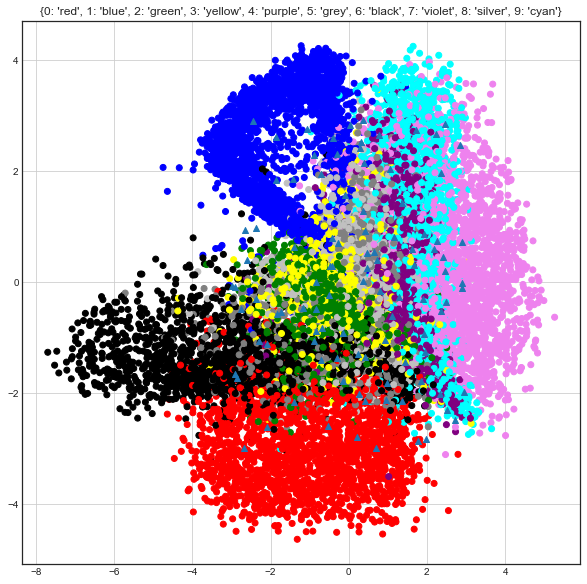

 iter: 10 batch: 19900 recon    cost: 0.17828919 dis one  cost: 0.59549826								 dis zero cost: 0.51931417 fake     cost: 1.5202157

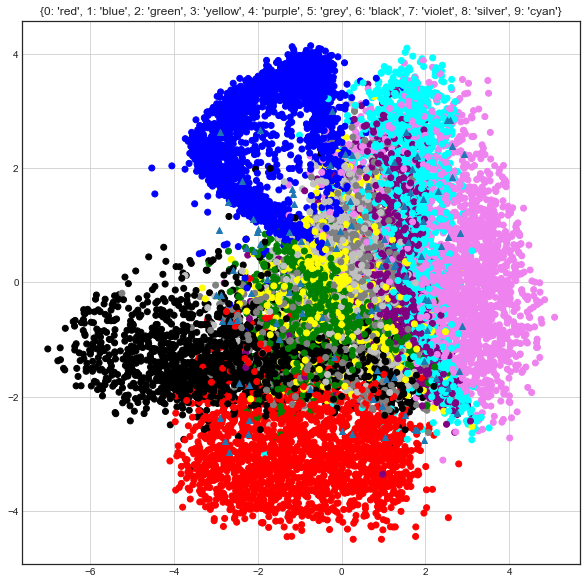

 iter: 11 batch: 19900 recon    cost: 0.17757884 dis one  cost: 0.63848764								 dis zero cost: 0.557414 fake     cost: 1.2972811585

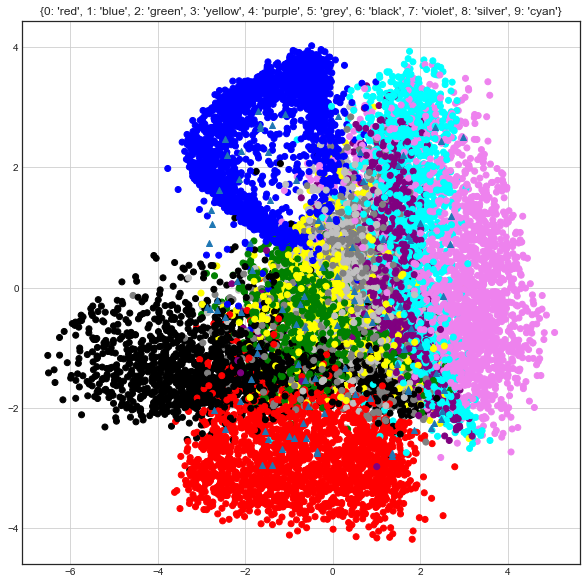

 iter: 12 batch: 19900 recon    cost: 0.17686217 dis one  cost: 0.6420825								 dis zero cost: 0.48114967 fake     cost: 1.23658187

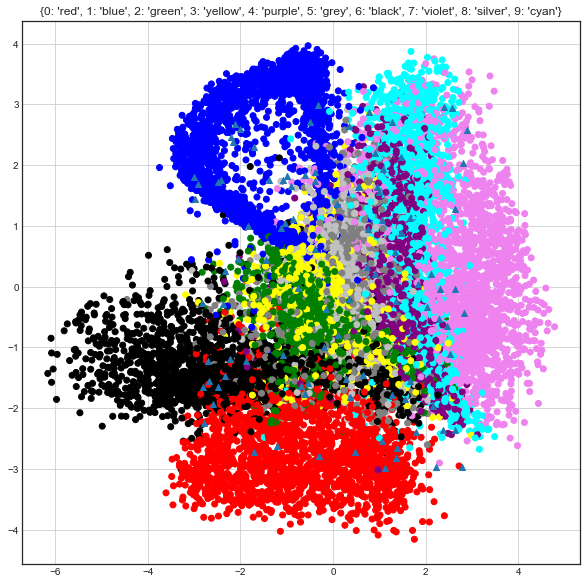

 iter: 13 batch: 19900 recon    cost: 0.17606553 dis one  cost: 0.6190358								 dis zero cost: 0.5108734 fake     cost: 1.186362629

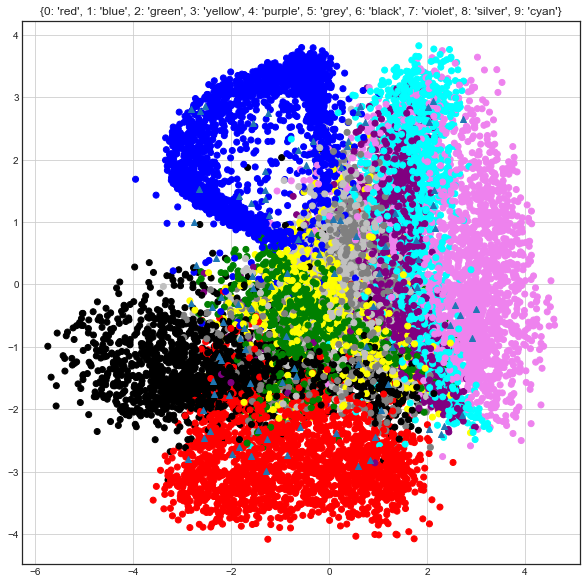

 iter: 14 batch: 19900 recon    cost: 0.17544653 dis one  cost: 0.5988696								 dis zero cost: 0.50695366 fake     cost: 1.14084847

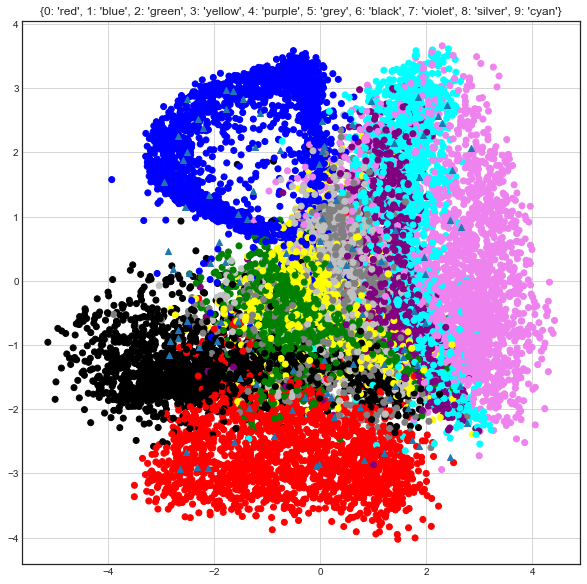

 iter: 15 batch: 19900 recon    cost: 0.17445353 dis one  cost: 0.593247								 dis zero cost: 0.52718544 fake     cost: 1.149333453

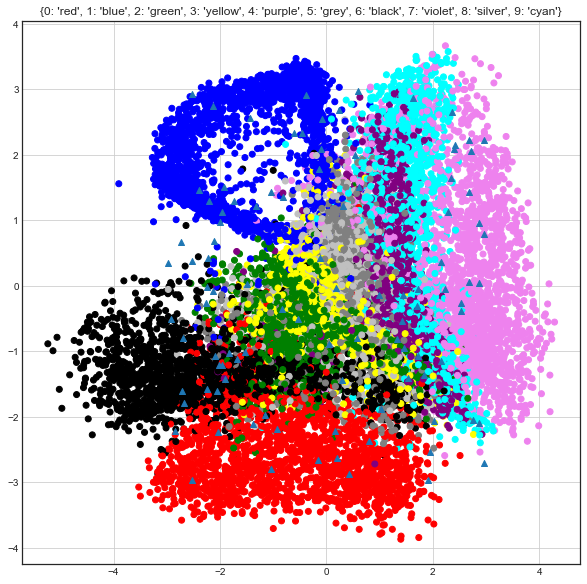

 iter: 16 batch: 19900 recon    cost: 0.17419364 dis one  cost: 0.6158259								 dis zero cost: 0.5533068 fake     cost: 1.0044574423

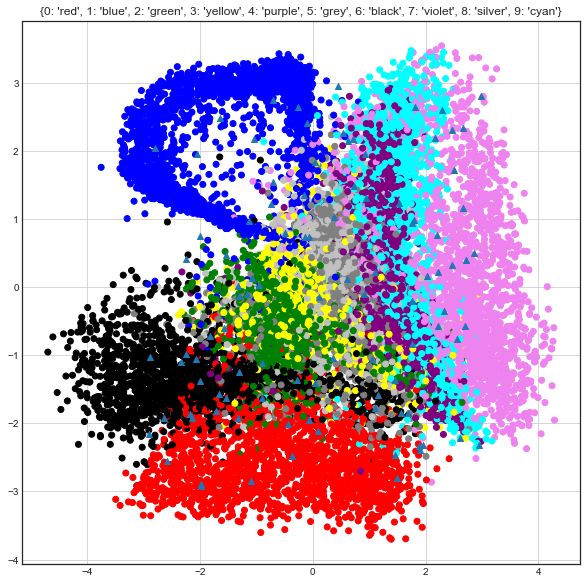

 iter: 17 batch: 19900 recon    cost: 0.1734022 dis one  cost: 0.6119026								 dis zero cost: 0.5790789 fake     cost: 1.0254664591

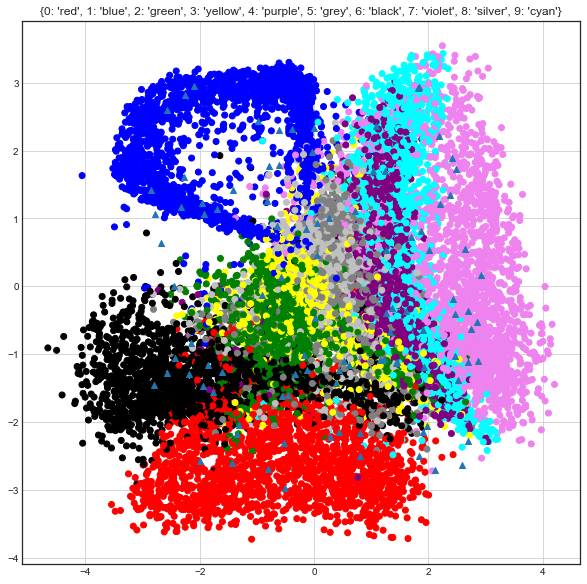

 iter: 18 batch: 19900 recon    cost: 0.17283851 dis one  cost: 0.56609964								 dis zero cost: 0.5665545 fake     cost: 1.10089044

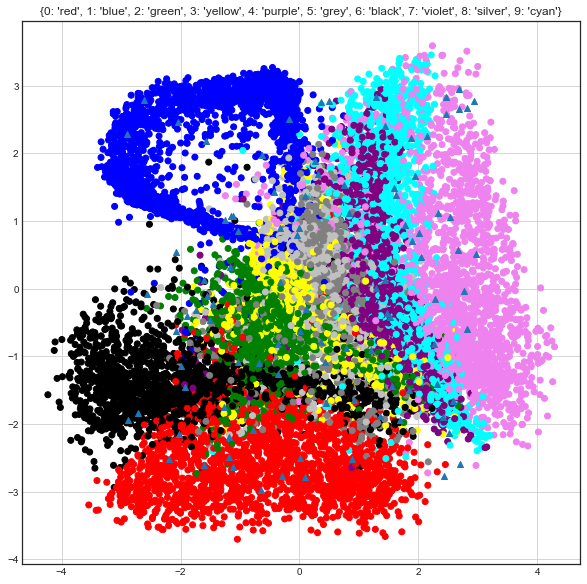

 iter: 19 batch: 19900 recon    cost: 0.17245069 dis one  cost: 0.58817744								 dis zero cost: 0.55597377 fake     cost: 1.0894086

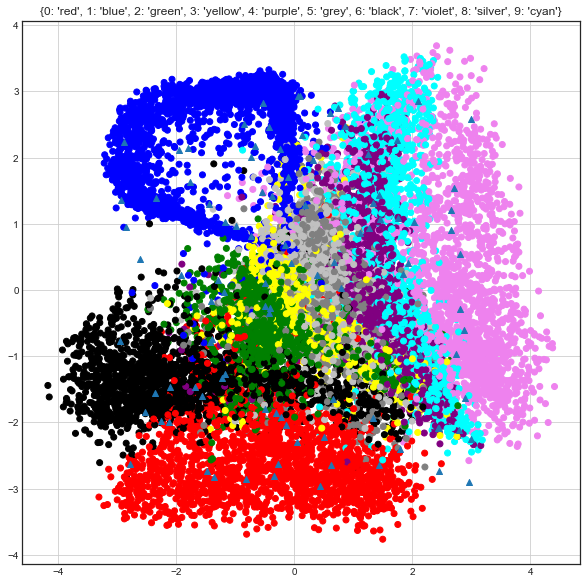

 iter: 20 batch: 19900 recon    cost: 0.17194931 dis one  cost: 0.6161804								 dis zero cost: 0.573258 fake     cost: 0.97400211585

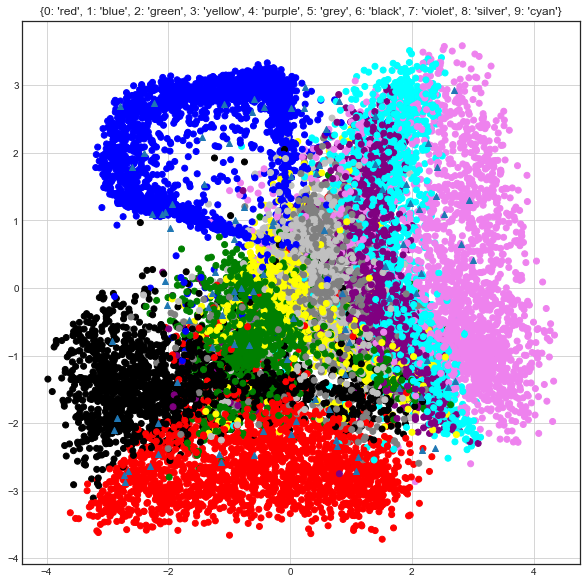

 iter: 21 batch: 19900 recon    cost: 0.17120577 dis one  cost: 0.5866747								 dis zero cost: 0.672242 fake     cost: 1.0246993779

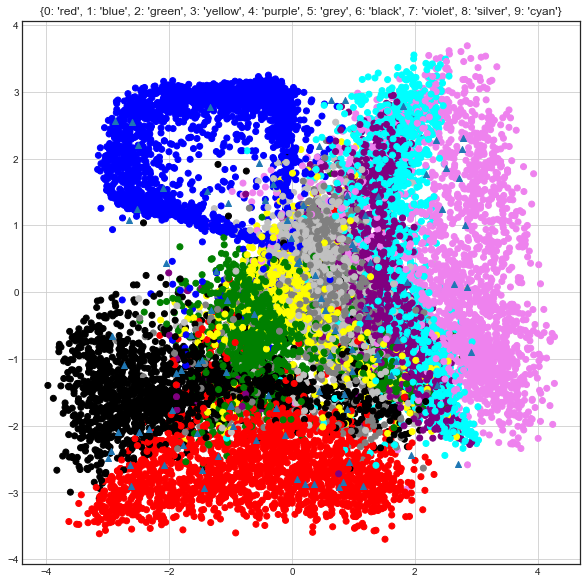

 iter: 22 batch: 19900 recon    cost: 0.17059042 dis one  cost: 0.60884625								 dis zero cost: 0.5707368 fake     cost: 0.98944492

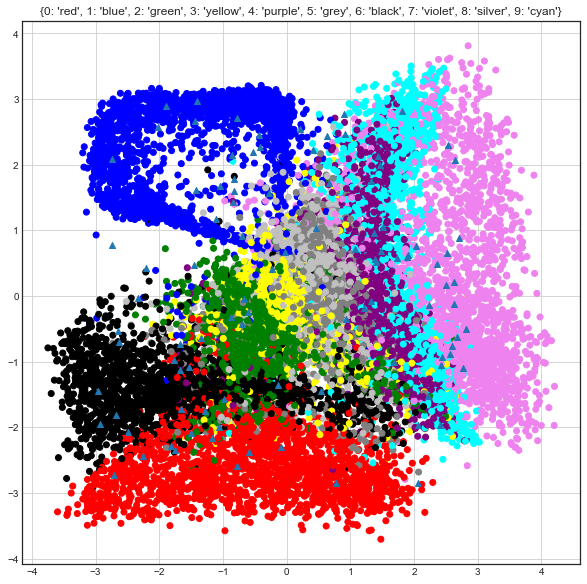

 iter: 23 batch: 19900 recon    cost: 0.17004733 dis one  cost: 0.61377275								 dis zero cost: 0.5734594 fake     cost: 1.010792176

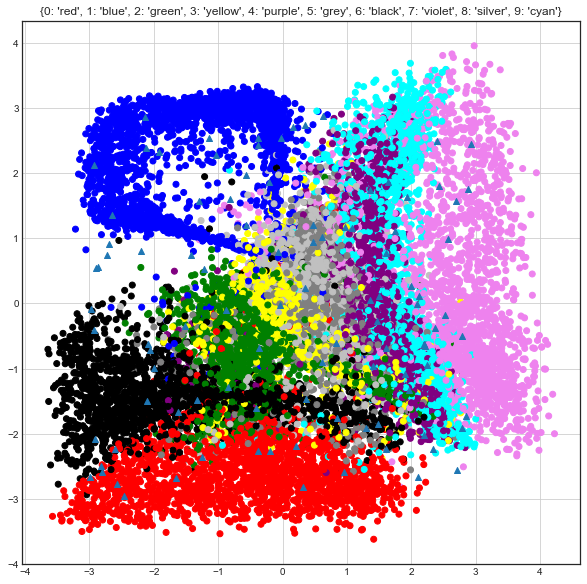

 iter: 24 batch: 19900 recon    cost: 0.1694692 dis one  cost: 0.5816208								 dis zero cost: 0.5974565 fake     cost: 1.03831742344

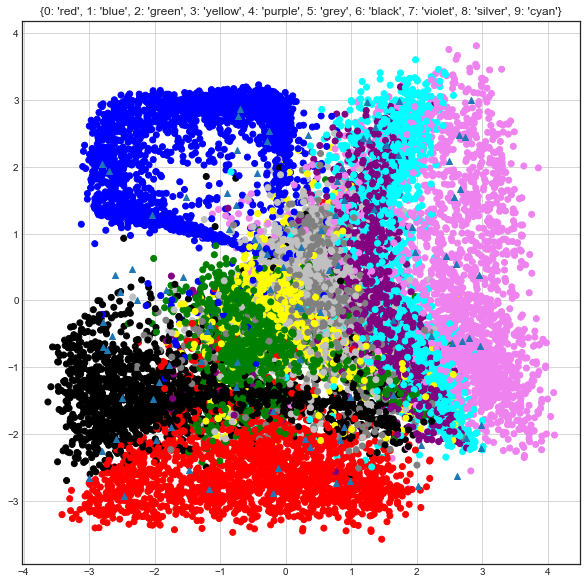

 iter: 25 batch: 19900 recon    cost: 0.16903134 dis one  cost: 0.6111808								 dis zero cost: 0.6482523 fake     cost: 0.9575029613

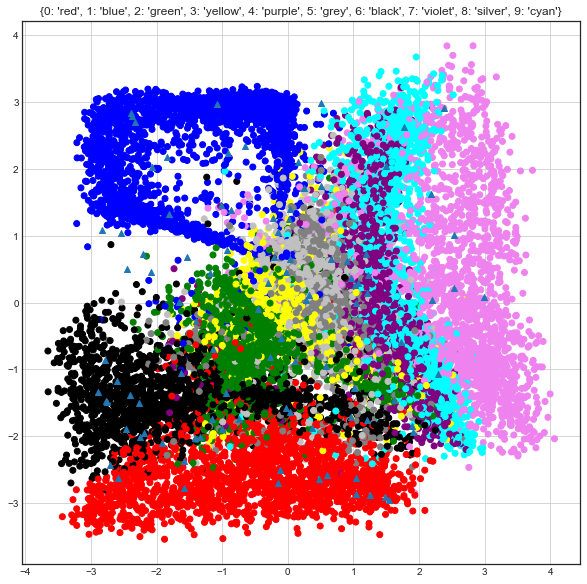

 iter: 26 batch: 19900 recon    cost: 0.16856635 dis one  cost: 0.59188676								 dis zero cost: 0.5782812 fake     cost: 1.077809343

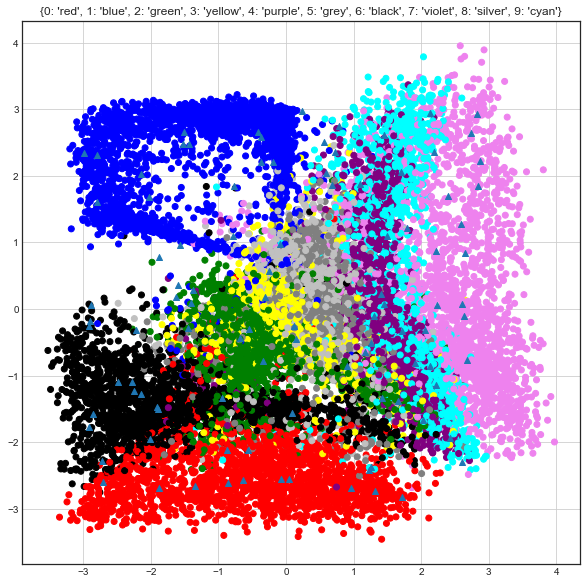

 iter: 27 batch: 19900 recon    cost: 0.16808705 dis one  cost: 0.5750077								 dis zero cost: 0.63026744 fake     cost: 1.058923824

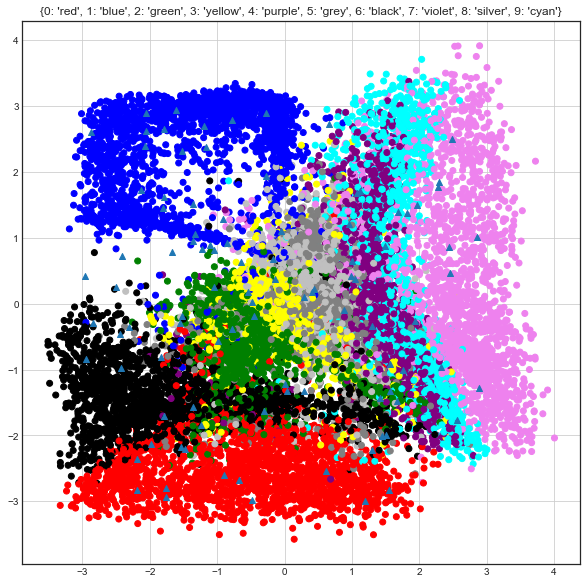

 iter: 28 batch: 19900 recon    cost: 0.16757308 dis one  cost: 0.5991389								 dis zero cost: 0.5655514 fake     cost: 1.008684581

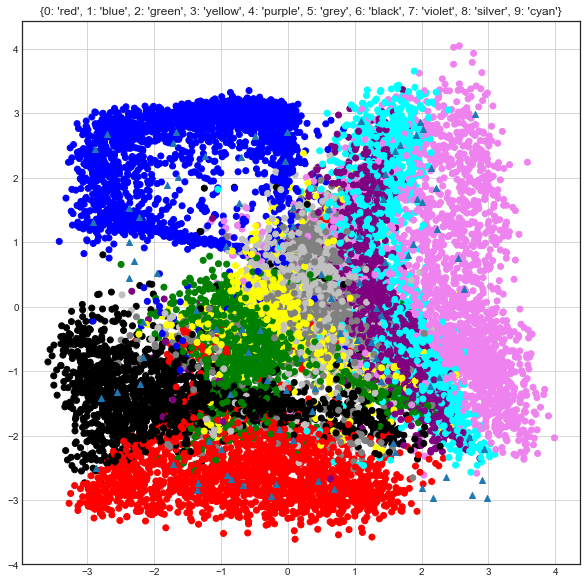

 iter: 29 batch: 19900 recon    cost: 0.16740109 dis one  cost: 0.5501526								 dis zero cost: 0.53477633 fake     cost: 1.210154876

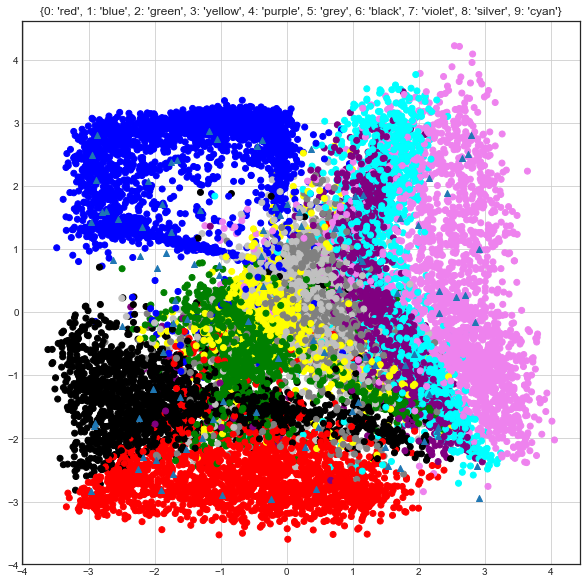

 iter: 30 batch: 19900 recon    cost: 0.16699336 dis one  cost: 0.5437757								 dis zero cost: 0.4924996 fake     cost: 1.4651196955

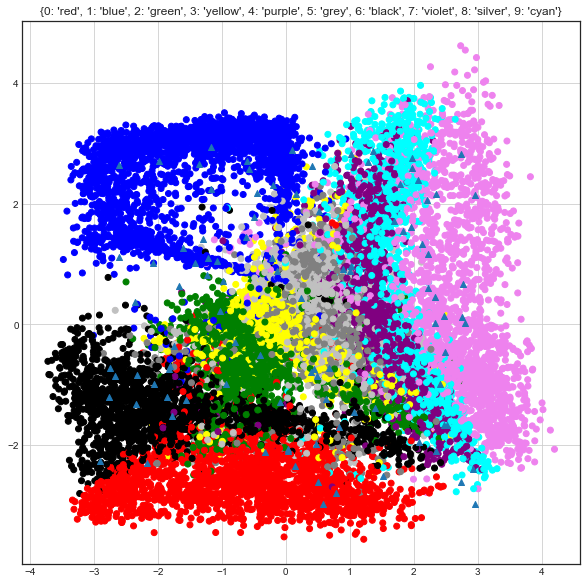

 iter: 31 batch: 19900 recon    cost: 0.16621216 dis one  cost: 0.55390626								 dis zero cost: 0.58545417 fake     cost: 1.29465274

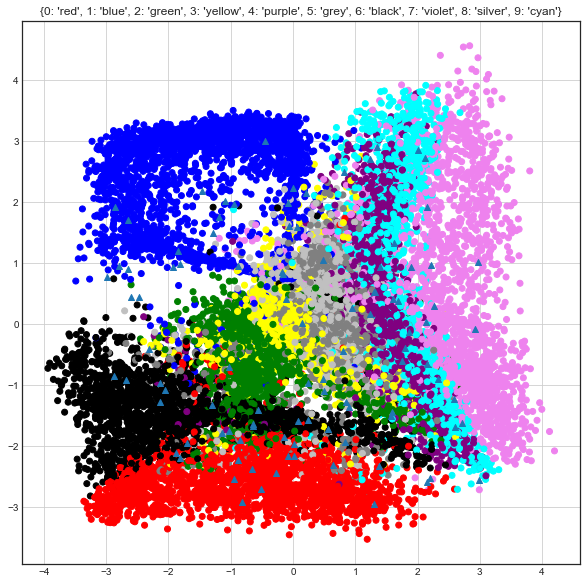

 iter: 32 batch: 19900 recon    cost: 0.16564225 dis one  cost: 0.59788185								 dis zero cost: 0.59465235 fake     cost: 1.20006845

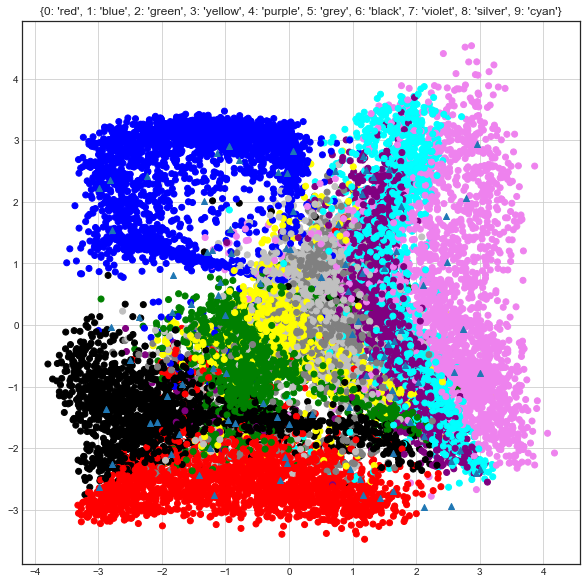

 iter: 33 batch: 19900 recon    cost: 0.16531387 dis one  cost: 0.62302434								 dis zero cost: 0.4935406 fake     cost: 1.099196424

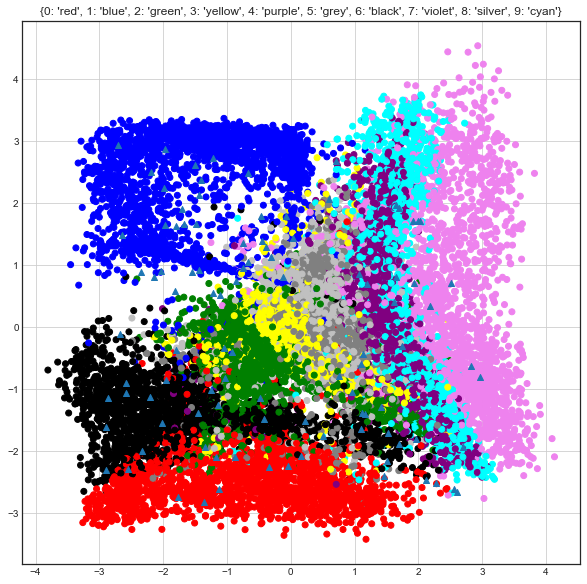

 iter: 34 batch: 19900 recon    cost: 0.16493294 dis one  cost: 0.6684196								 dis zero cost: 0.60996443 fake     cost: 0.960901556

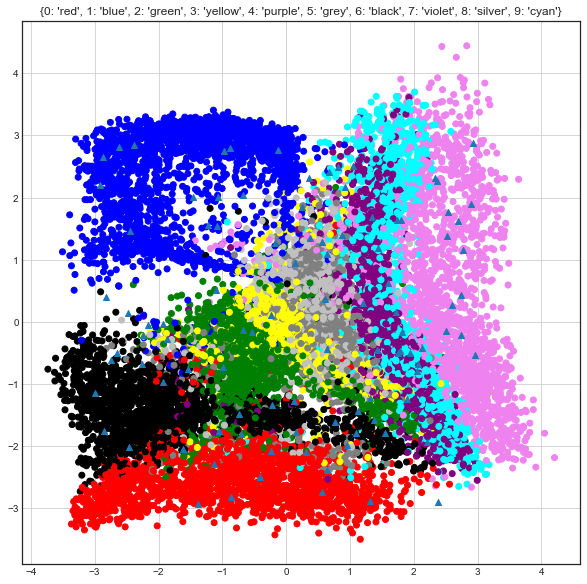

 iter: 35 batch: 19900 recon    cost: 0.16453557 dis one  cost: 0.67871267								 dis zero cost: 0.543327 fake     cost: 0.9140826554

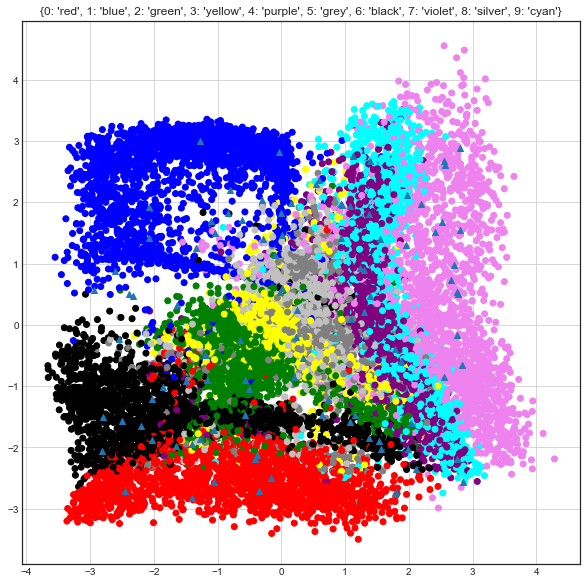

 iter: 36 batch: 19900 recon    cost: 0.16413614 dis one  cost: 0.70241755								 dis zero cost: 0.5478582 fake     cost: 0.921522446

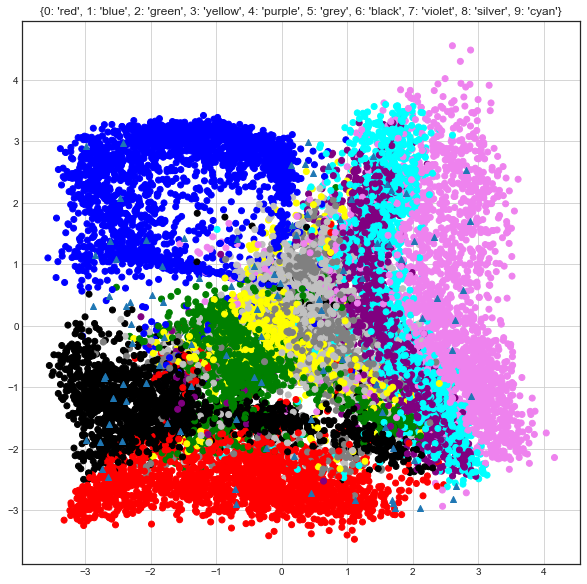

 iter: 37 batch: 19900 recon    cost: 0.16406141 dis one  cost: 0.71253115								 dis zero cost: 0.6299422 fake     cost: 0.871742666

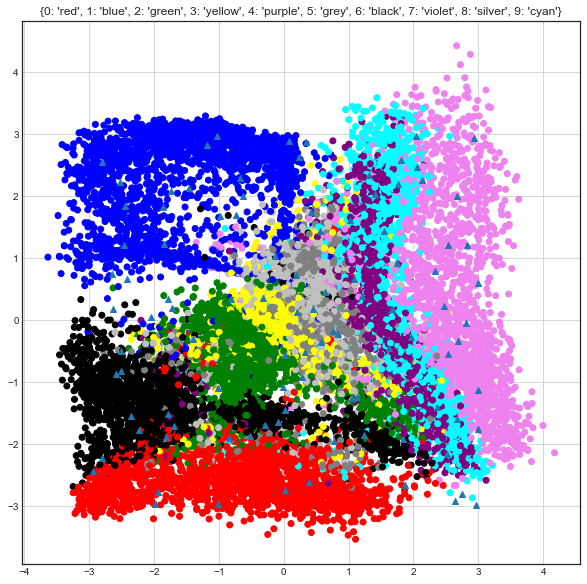

 iter: 38 batch: 19900 recon    cost: 0.16357207 dis one  cost: 0.7205415								 dis zero cost: 0.57553375 fake     cost: 0.877370367

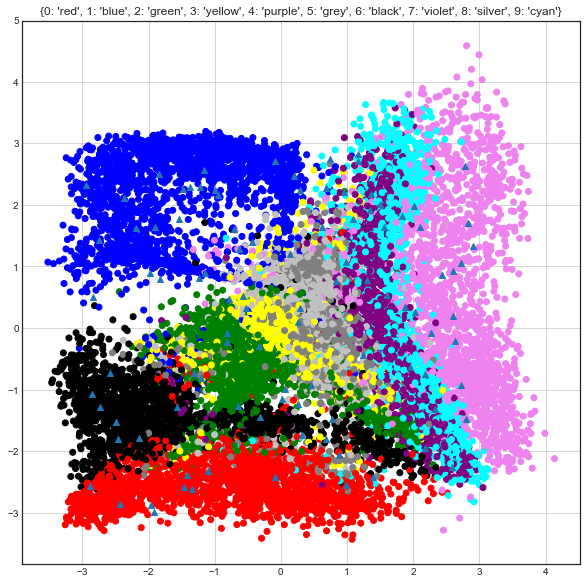

 iter: 39 batch: 19900 recon    cost: 0.16345416 dis one  cost: 0.72570395								 dis zero cost: 0.55953 fake     cost: 0.87642799904

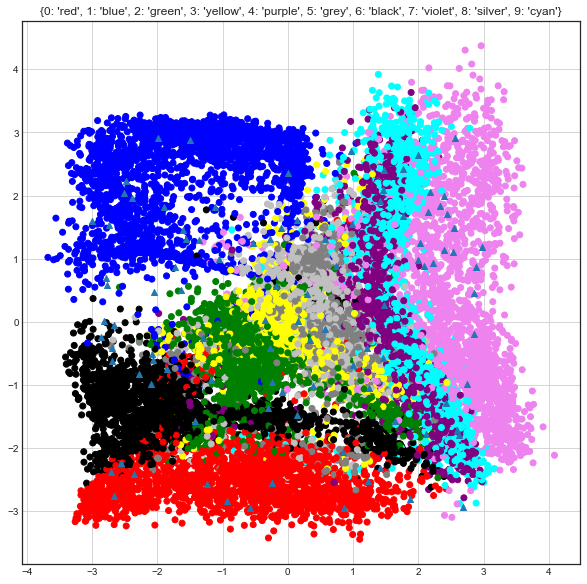

 iter: 40 batch: 19900 recon    cost: 0.16306473 dis one  cost: 0.72100645								 dis zero cost: 0.5887012 fake     cost: 0.880385344

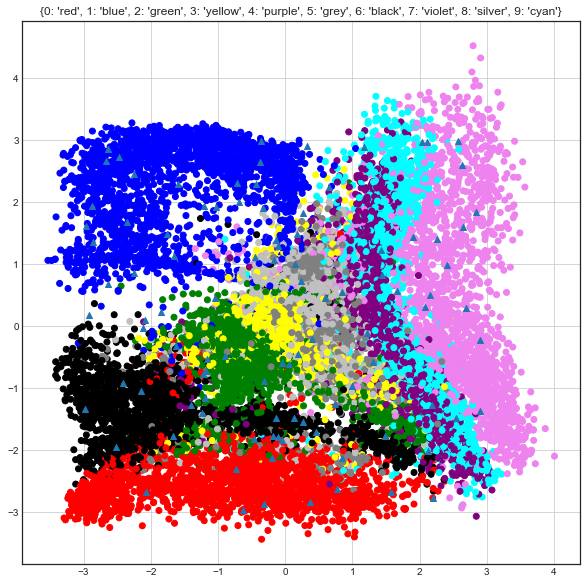

 iter: 41 batch: 19900 recon    cost: 0.16276067 dis one  cost: 0.6827197								 dis zero cost: 0.53165895 fake     cost: 1.008917144

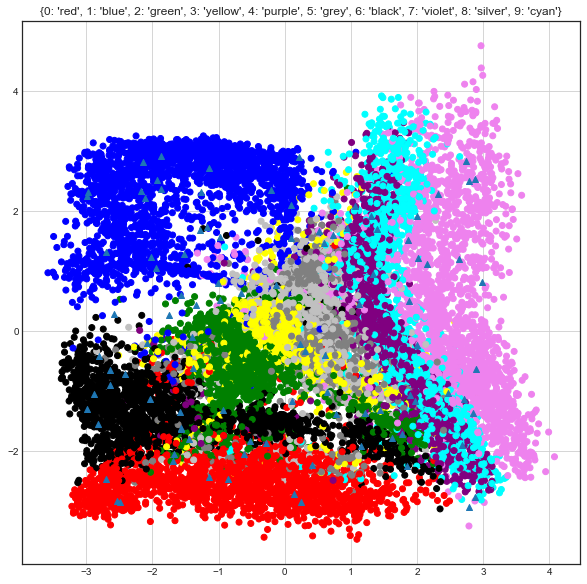

 iter: 42 batch: 19900 recon    cost: 0.16274303 dis one  cost: 0.72735476								 dis zero cost: 0.57774043 fake     cost: 0.96586593

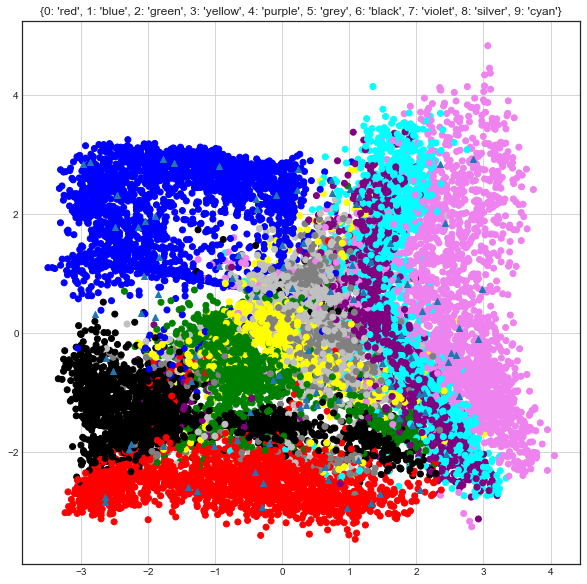

 iter: 43 batch: 19900 recon    cost: 0.16269366 dis one  cost: 0.70785934								 dis zero cost: 0.57970244 fake     cost: 0.91891843

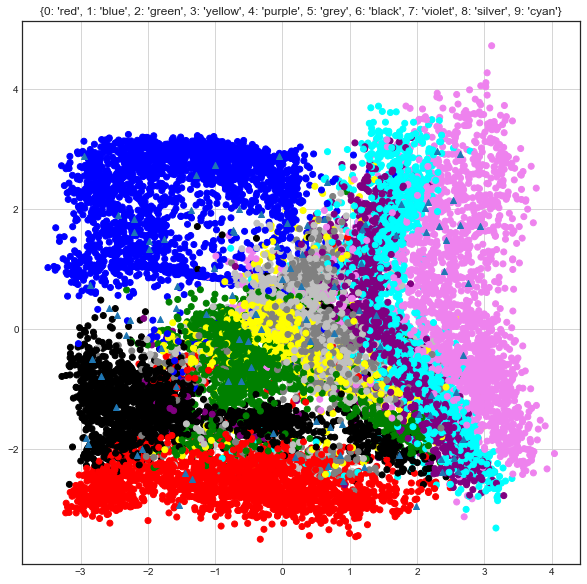

 iter: 44 batch: 19900 recon    cost: 0.1619128 dis one  cost: 0.70064384								 dis zero cost: 0.53637177 fake     cost: 0.926683967

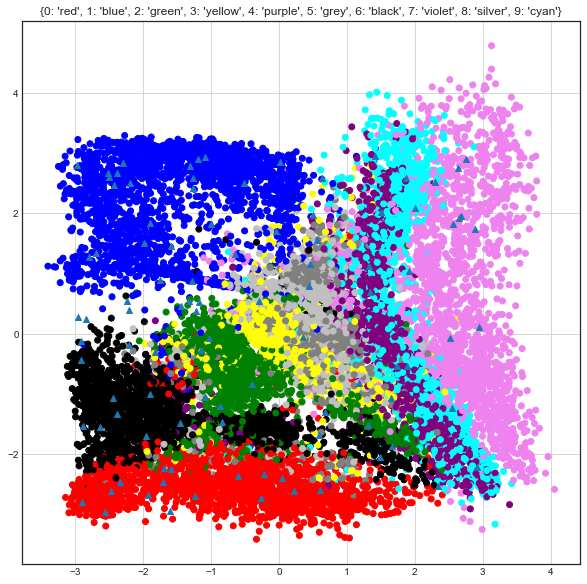

 iter: 45 batch: 19900 recon    cost: 0.16189305 dis one  cost: 0.62808186								 dis zero cost: 0.5902239 fake     cost: 1.240147665

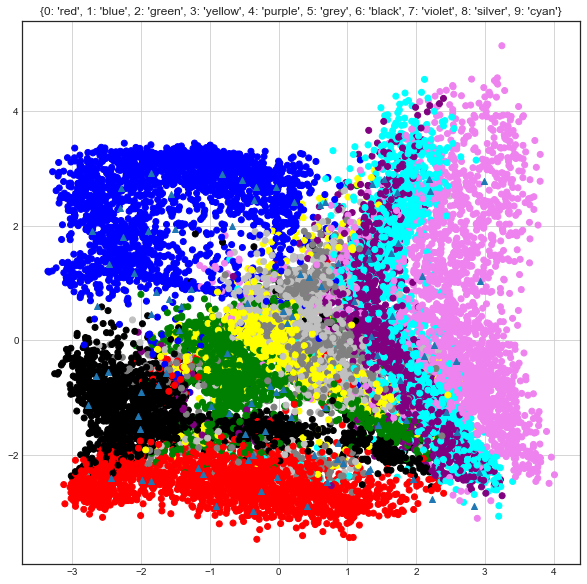

 iter: 46 batch: 19900 recon    cost: 0.16265392 dis one  cost: 0.75532633								 dis zero cost: 0.5825697 fake     cost: 0.82434336

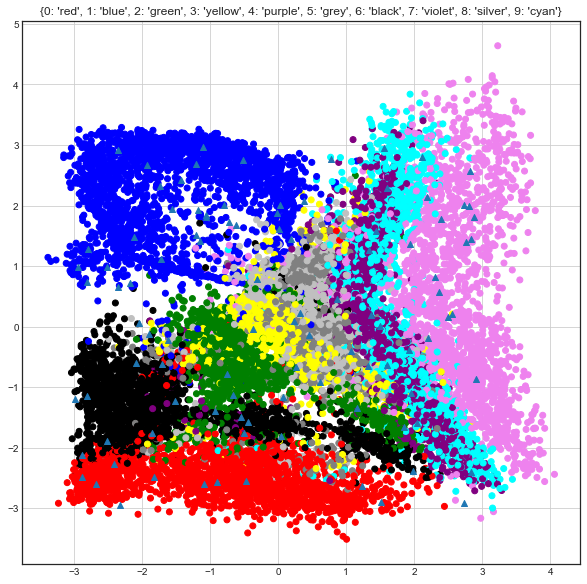

 iter: 47 batch: 19900 recon    cost: 0.16200182 dis one  cost: 0.7371167								 dis zero cost: 0.6389525 fake     cost: 0.8224656674

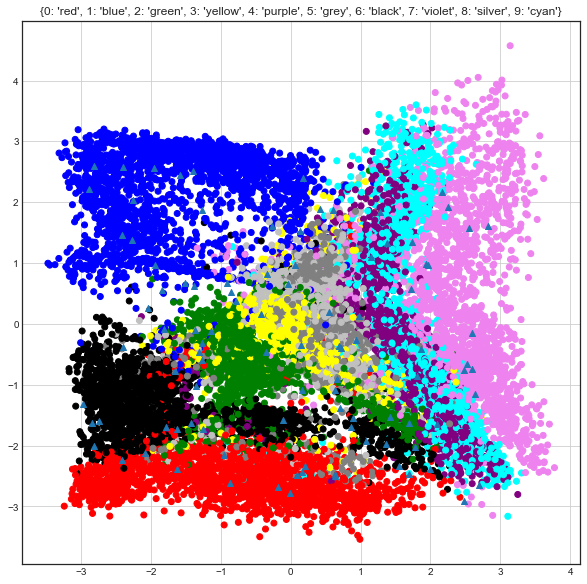

 iter: 48 batch: 19900 recon    cost: 0.16164333 dis one  cost: 0.76298815								 dis zero cost: 0.5543017 fake     cost: 0.806184234

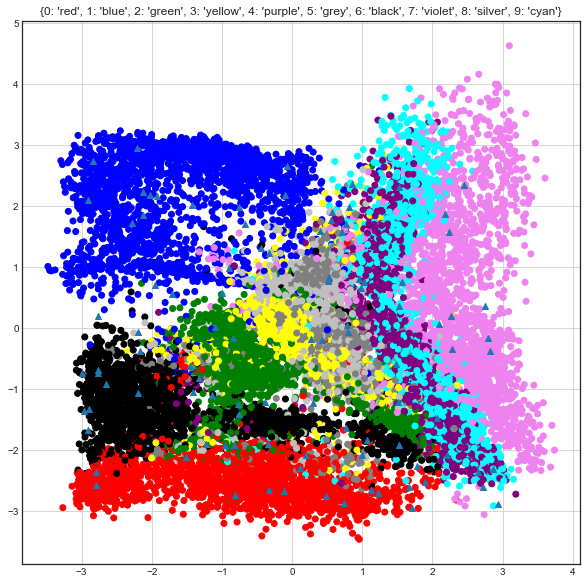

 iter: 49 batch: 19900 recon    cost: 0.16104071 dis one  cost: 0.75176424								 dis zero cost: 0.63702303 fake     cost: 0.82404363

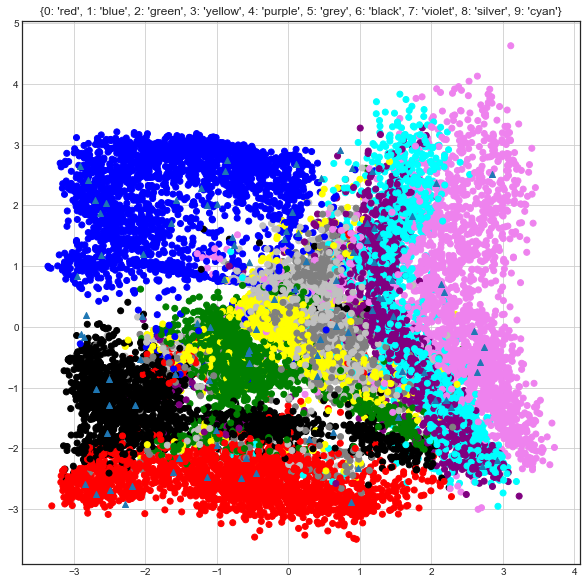

 iter: 50 batch: 19900 recon    cost: 0.16109756 dis one  cost: 0.73868334								 dis zero cost: 0.60461867 fake     cost: 0.82575944

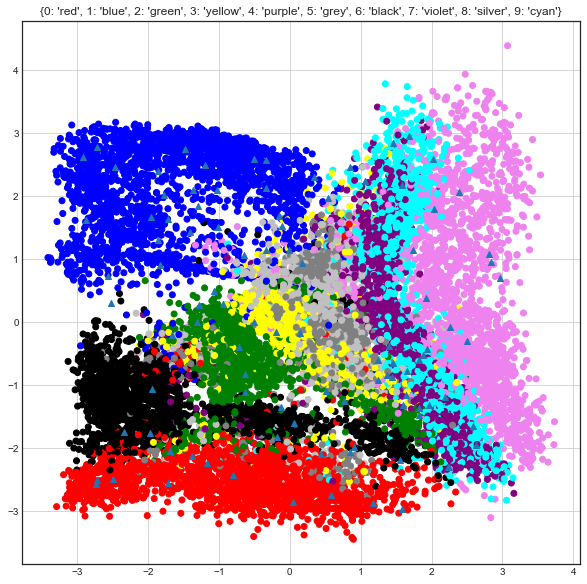

 iter: 51 batch: 19900 recon    cost: 0.16077538 dis one  cost: 0.71644133								 dis zero cost: 0.60469854 fake     cost: 0.90552045

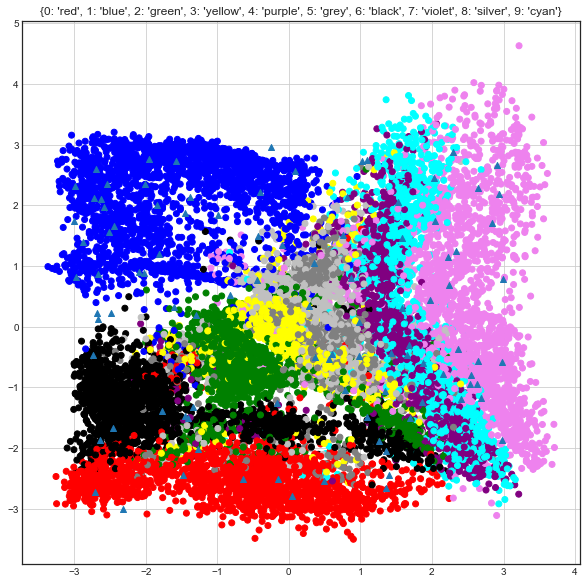

 iter: 52 batch: 19900 recon    cost: 0.16054459 dis one  cost: 0.7243031								 dis zero cost: 0.5130048 fake     cost: 0.9283472306

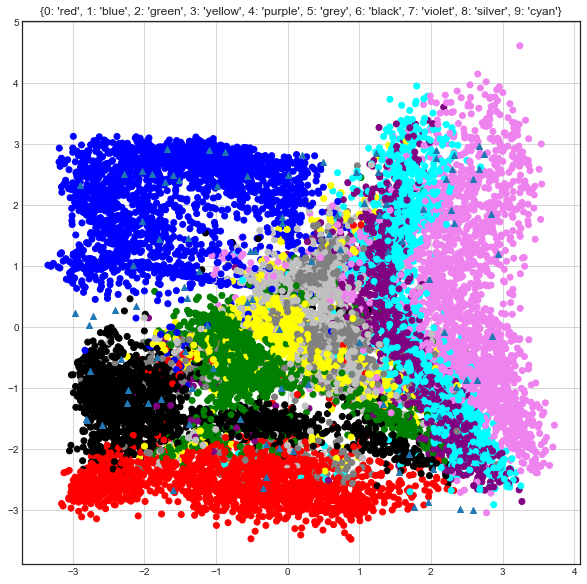

 iter: 53 batch: 19900 recon    cost: 0.16047701 dis one  cost: 0.7285173								 dis zero cost: 0.60505146 fake     cost: 0.904647474

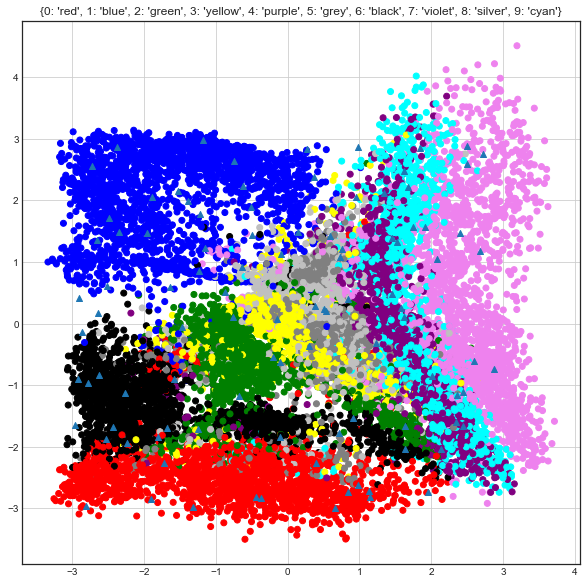

 iter: 54 batch: 19900 recon    cost: 0.16033494 dis one  cost: 0.7405838								 dis zero cost: 0.6613109 fake     cost: 0.8907677753

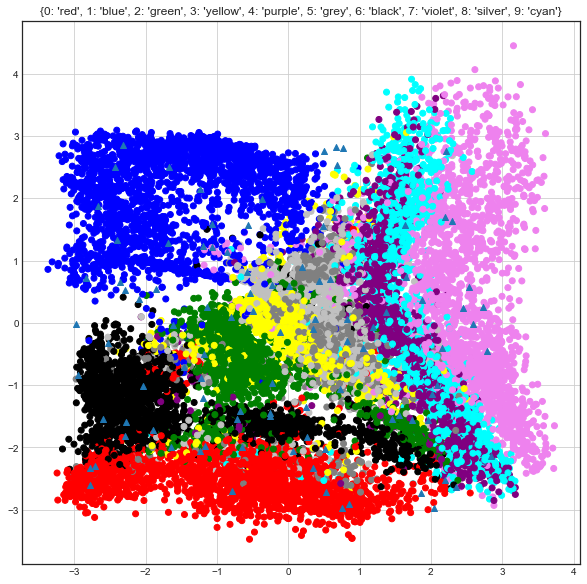

 iter: 55 batch: 19900 recon    cost: 0.1602576 dis one  cost: 0.7504389								 dis zero cost: 0.57714313 fake     cost: 0.8338586764

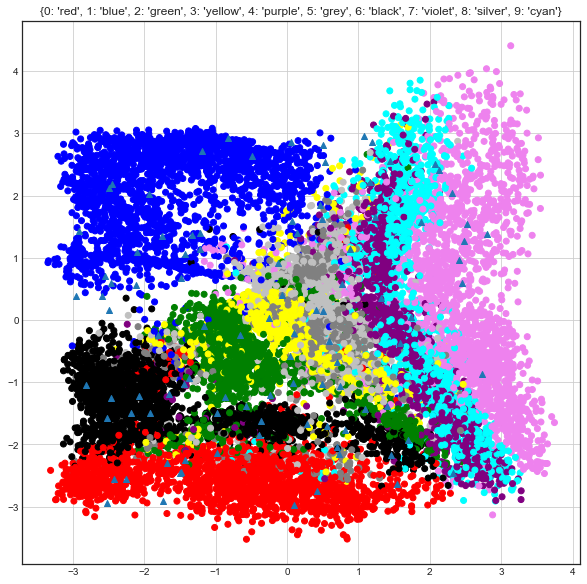

 iter: 56 batch: 19900 recon    cost: 0.16009277 dis one  cost: 0.72082084								 dis zero cost: 0.6343161 fake     cost: 0.923797556

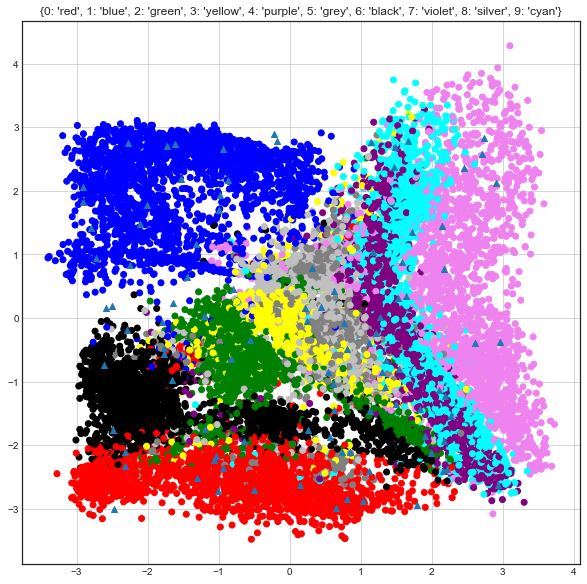

 iter: 57 batch: 19900 recon    cost: 0.15979913 dis one  cost: 0.74030775								 dis zero cost: 0.5474907 fake     cost: 0.931712944

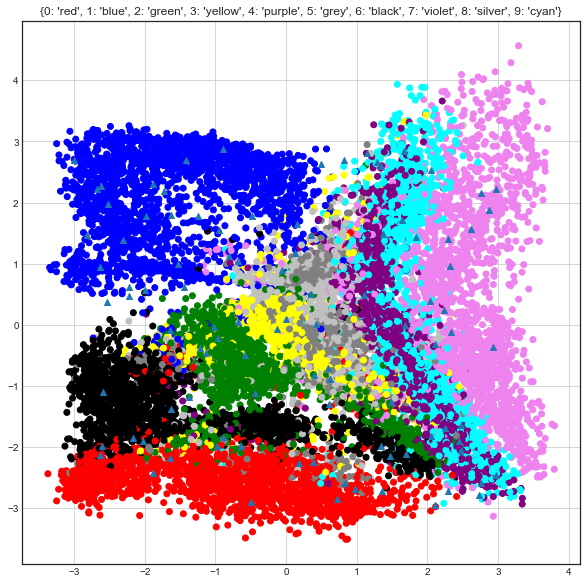

 iter: 58 batch: 19900 recon    cost: 0.15972698 dis one  cost: 0.68880194								 dis zero cost: 0.6159279 fake     cost: 0.978916286

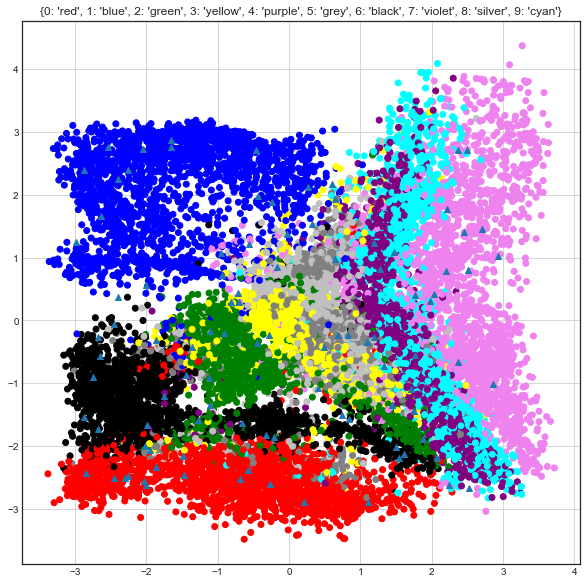

 iter: 59 batch: 19900 recon    cost: 0.16004461 dis one  cost: 0.7399826								 dis zero cost: 0.65755767 fake     cost: 0.938375313

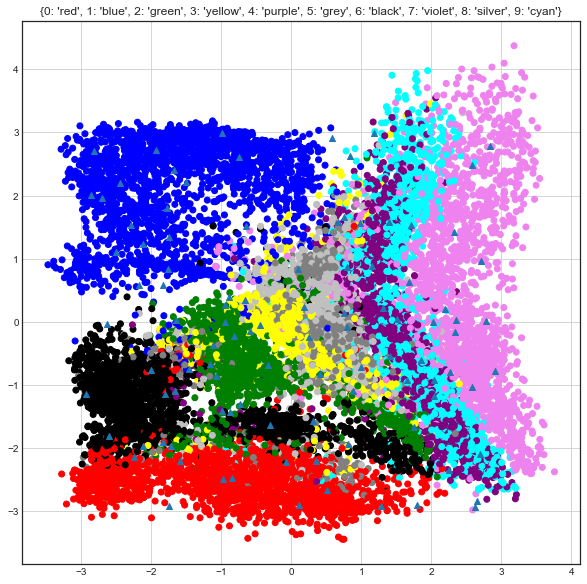

 iter: 60 batch: 19900 recon    cost: 0.1600275 dis one  cost: 0.7622041								 dis zero cost: 0.5580183 fake     cost: 0.79365575565

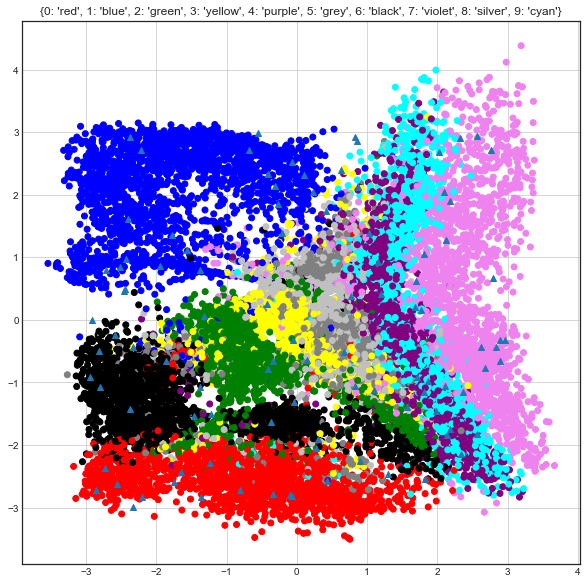

 iter: 61 batch: 19900 recon    cost: 0.15972479 dis one  cost: 0.72760093								 dis zero cost: 0.6188866 fake     cost: 0.866126226

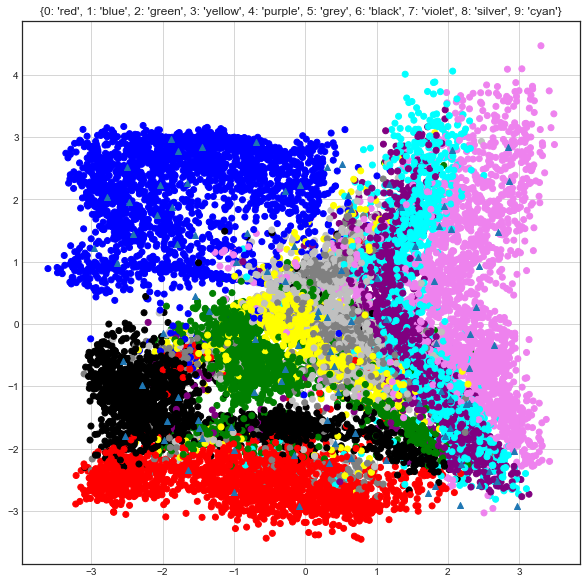

 iter: 62 batch: 19900 recon    cost: 0.15968975 dis one  cost: 0.75157076								 dis zero cost: 0.57268894 fake     cost: 0.84822277

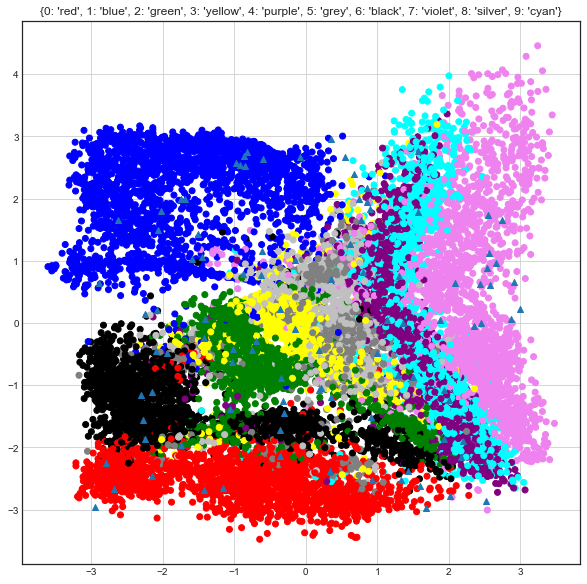

 iter: 63 batch: 19900 recon    cost: 0.15960225 dis one  cost: 0.7385181								 dis zero cost: 0.617138 fake     cost: 0.84058690435

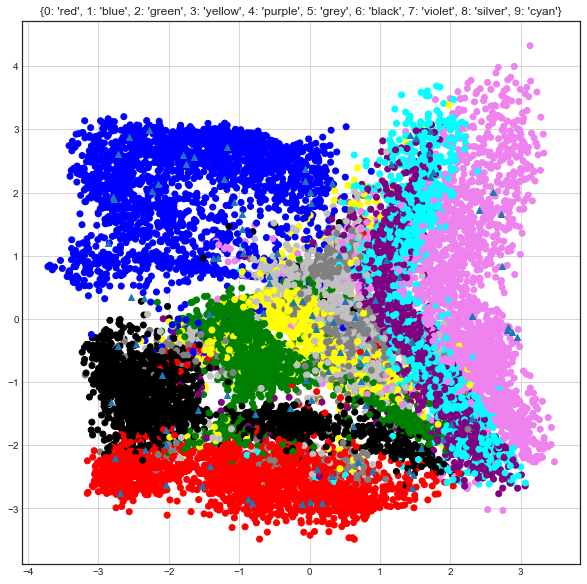

 iter: 64 batch: 19900 recon    cost: 0.15893725 dis one  cost: 0.758637								 dis zero cost: 0.5587256 fake     cost: 0.83082557146

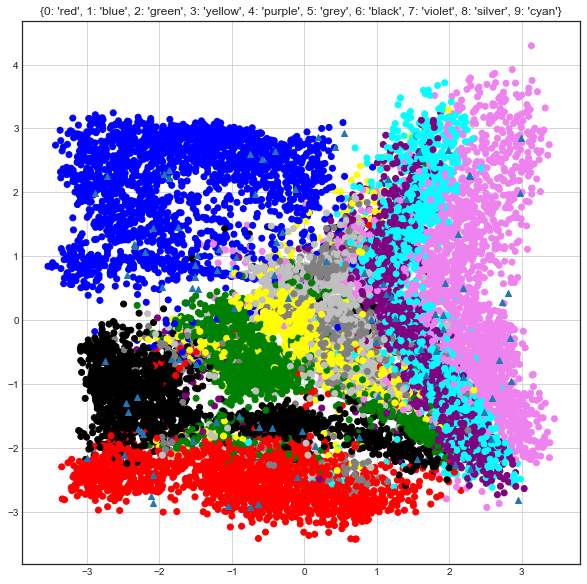

 iter: 65 batch: 19900 recon    cost: 0.15893625 dis one  cost: 0.7526316								 dis zero cost: 0.659713 fake     cost: 0.81464541814

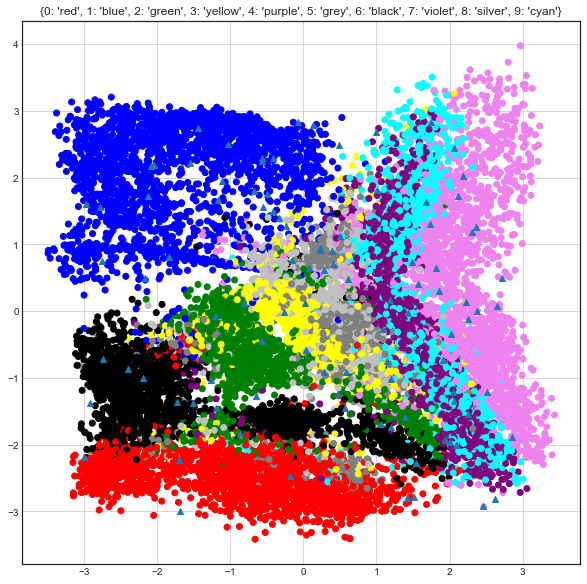

 iter: 66 batch: 19900 recon    cost: 0.15873745 dis one  cost: 0.74349236								 dis zero cost: 0.567337 fake     cost: 0.8295913663

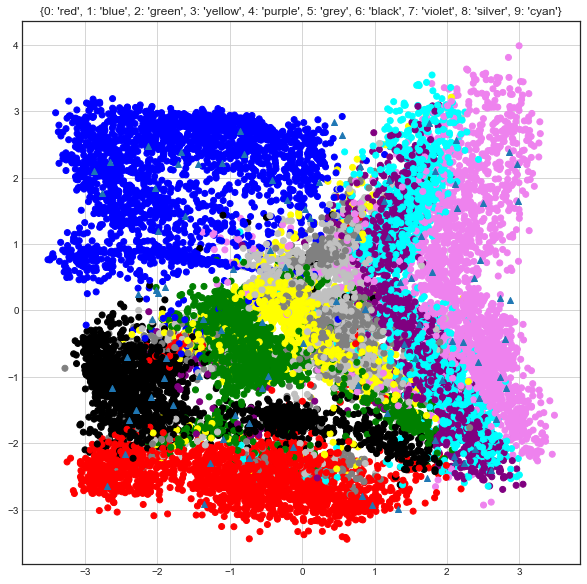

 iter: 67 batch: 19900 recon    cost: 0.158691 dis one  cost: 0.771884								 dis zero cost: 0.57289433 fake     cost: 0.798827102644

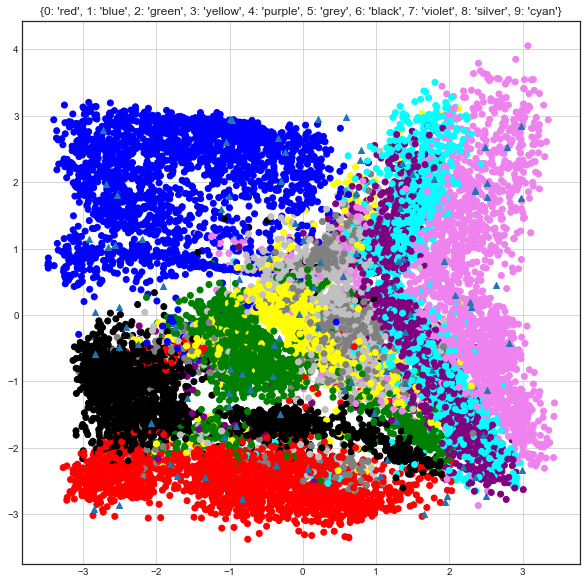

 iter: 68 batch: 19900 recon    cost: 0.15845957 dis one  cost: 0.7544929								 dis zero cost: 0.5658898 fake     cost: 0.803608545

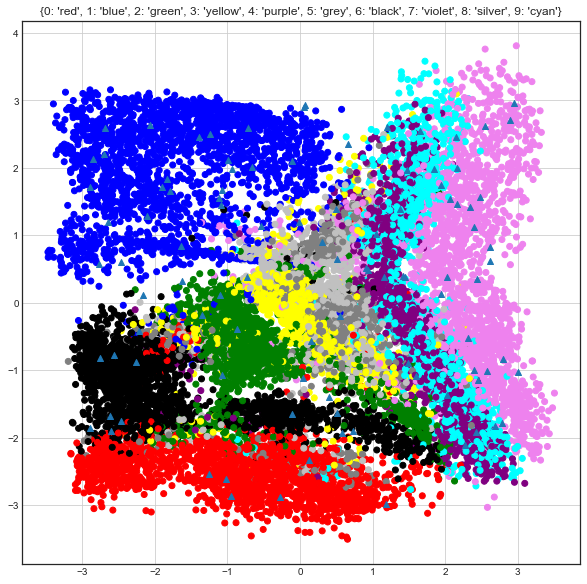

 iter: 69 batch: 19900 recon    cost: 0.15861289 dis one  cost: 0.74982804								 dis zero cost: 0.62811774 fake     cost: 0.81619954

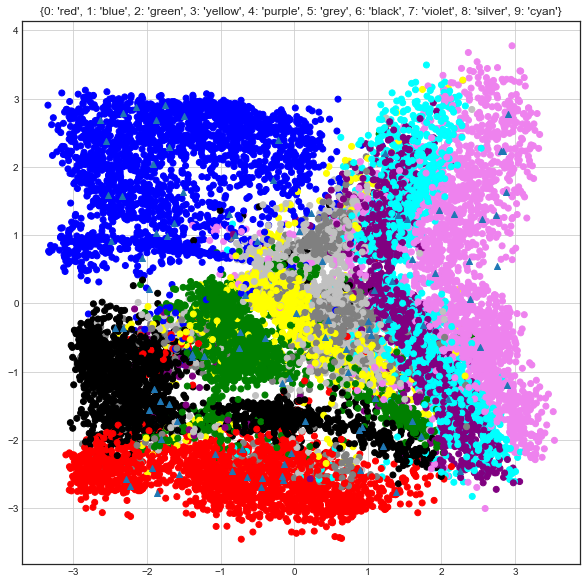

 iter: 70 batch: 19900 recon    cost: 0.15832938 dis one  cost: 0.73112977								 dis zero cost: 0.57237494 fake     cost: 0.87744644

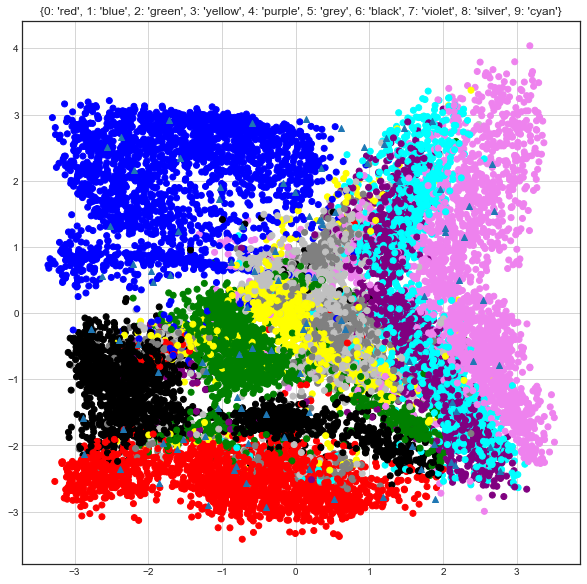

 iter: 71 batch: 19900 recon    cost: 0.1584409 dis one  cost: 0.7481814								 dis zero cost: 0.62228185 fake     cost: 0.8112024756

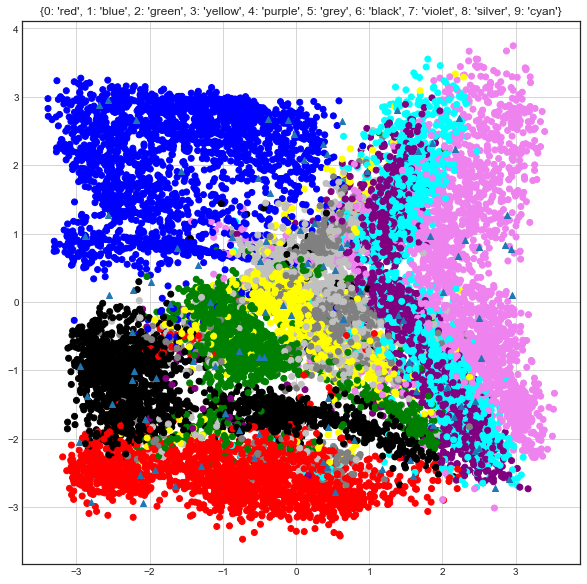

 iter: 72 batch: 19900 recon    cost: 0.15818368 dis one  cost: 0.72867835								 dis zero cost: 0.55517846 fake     cost: 0.84595596

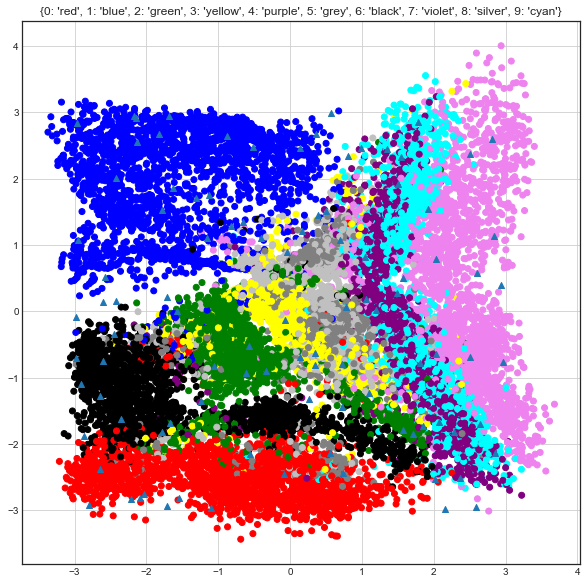

 iter: 73 batch: 19900 recon    cost: 0.15799311 dis one  cost: 0.7631463								 dis zero cost: 0.69182503 fake     cost: 0.816780146

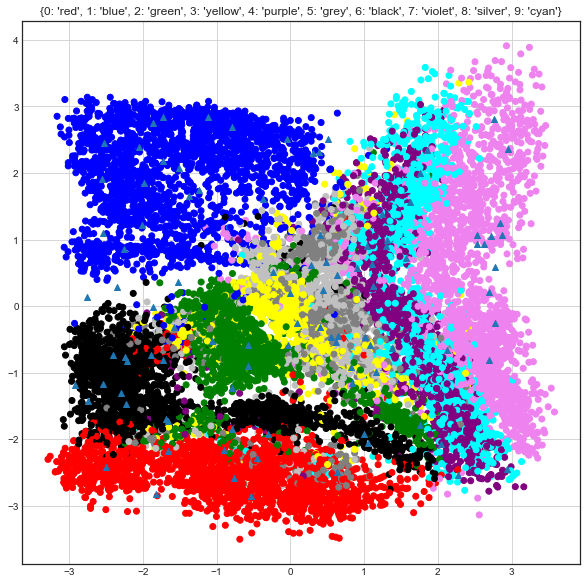

 iter: 74 batch: 19900 recon    cost: 0.15804967 dis one  cost: 0.72147804								 dis zero cost: 0.5992559 fake     cost: 0.879024453

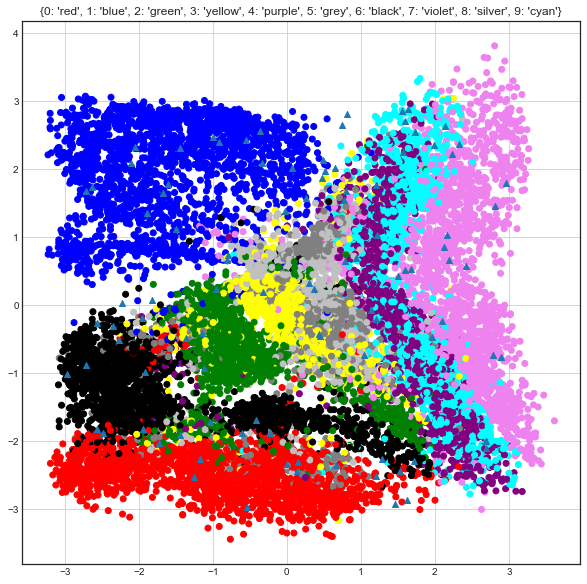

 iter: 75 batch: 19900 recon    cost: 0.15797116 dis one  cost: 0.75629354								 dis zero cost: 0.6284809 fake     cost: 0.791951066

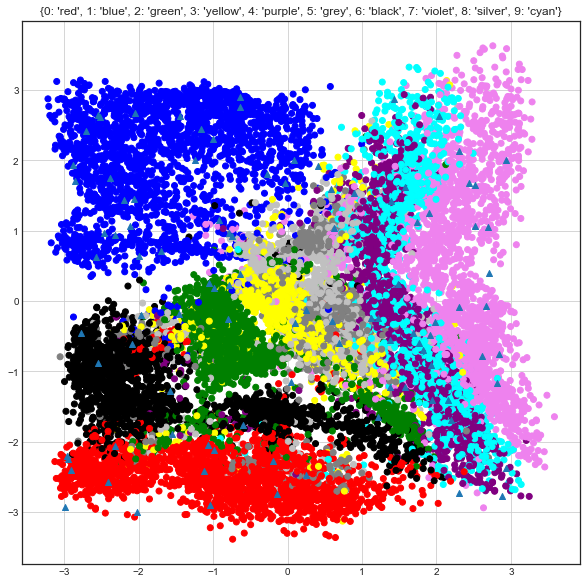

 iter: 76 batch: 19900 recon    cost: 0.15806891 dis one  cost: 0.7878683								 dis zero cost: 0.5729442 fake     cost: 0.7652885643

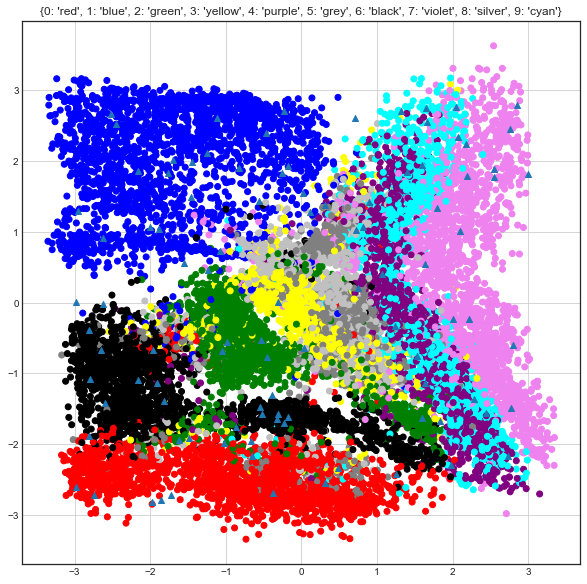

 iter: 77 batch: 19900 recon    cost: 0.15760809 dis one  cost: 0.79441583								 dis zero cost: 0.6216959 fake     cost: 0.762263244

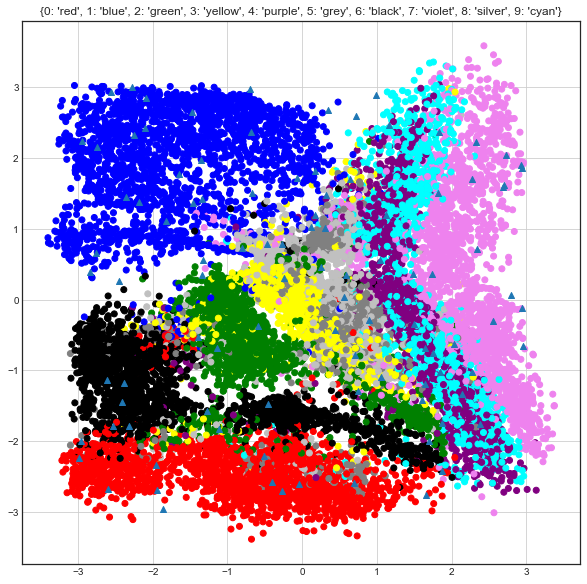

 iter: 78 batch: 19900 recon    cost: 0.15791424 dis one  cost: 0.75251776								 dis zero cost: 0.58229285 fake     cost: 0.83471626

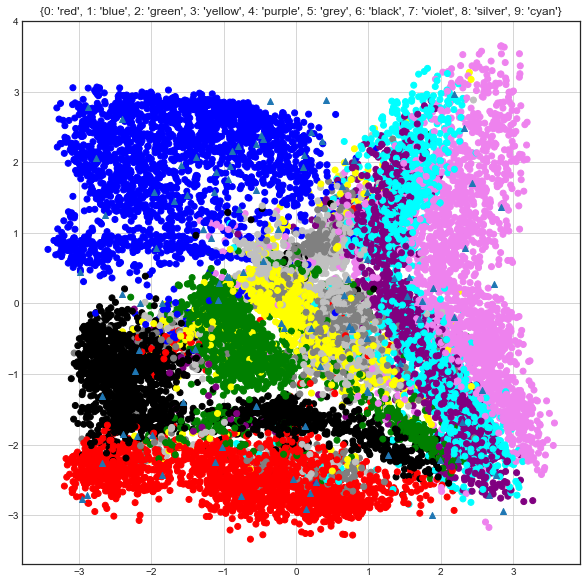

 iter: 79 batch: 19900 recon    cost: 0.15739506 dis one  cost: 0.74933463								 dis zero cost: 0.5961913 fake     cost: 0.841313263

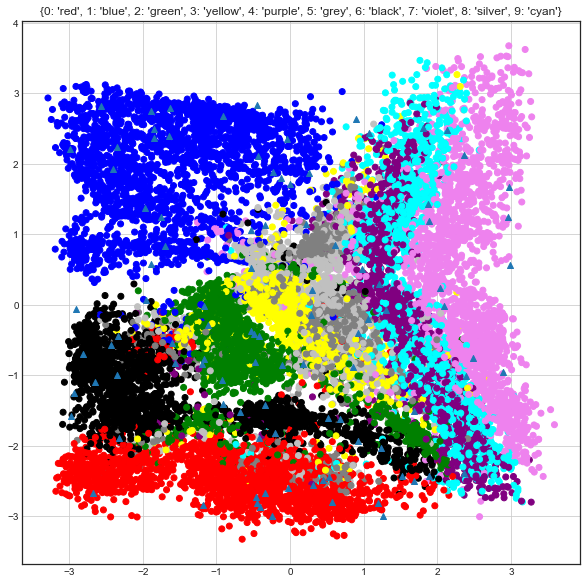

 iter: 80 batch: 19900 recon    cost: 0.1572869 dis one  cost: 0.7419229								 dis zero cost: 0.6332074 fake     cost: 0.82108646284

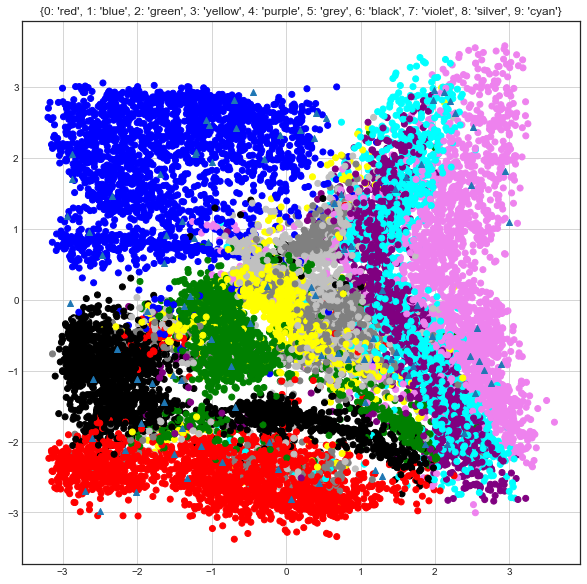

 iter: 81 batch: 19900 recon    cost: 0.15696497 dis one  cost: 0.7437788								 dis zero cost: 0.6190351 fake     cost: 0.8065824956

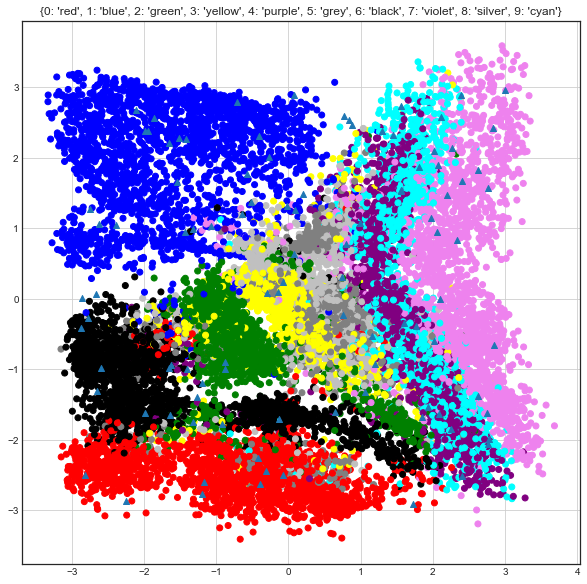

 iter: 82 batch: 19900 recon    cost: 0.15683962 dis one  cost: 0.73980004								 dis zero cost: 0.612425 fake     cost: 0.8122074634

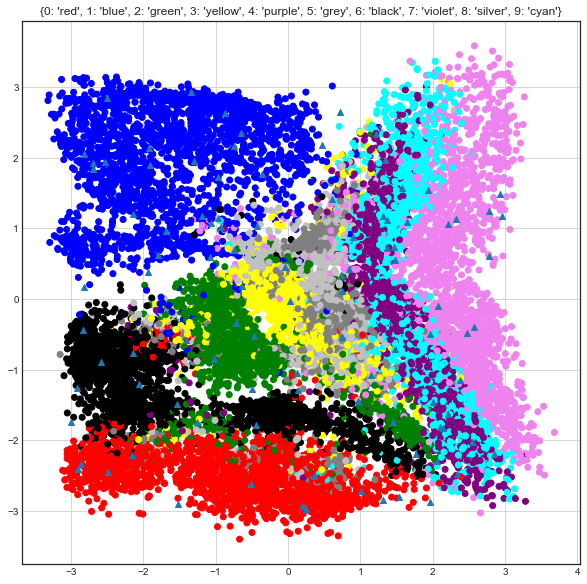

 iter: 83 batch: 19900 recon    cost: 0.15683863 dis one  cost: 0.7865396								 dis zero cost: 0.5825985 fake     cost: 0.7684206474

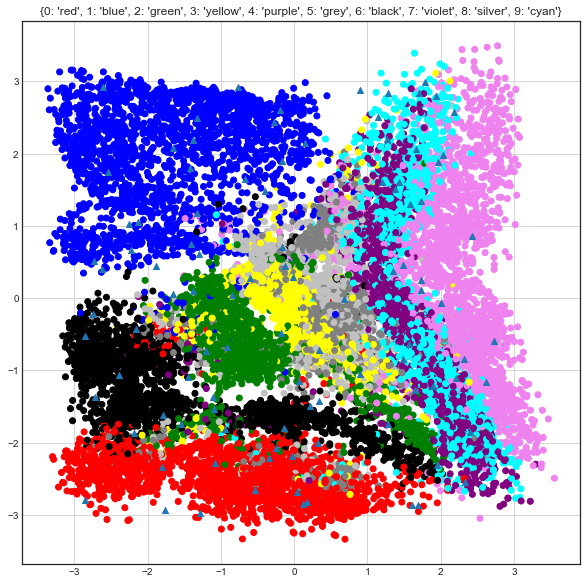

 iter: 84 batch: 19900 recon    cost: 0.15678388 dis one  cost: 0.7487664								 dis zero cost: 0.61128455 fake     cost: 0.798934465

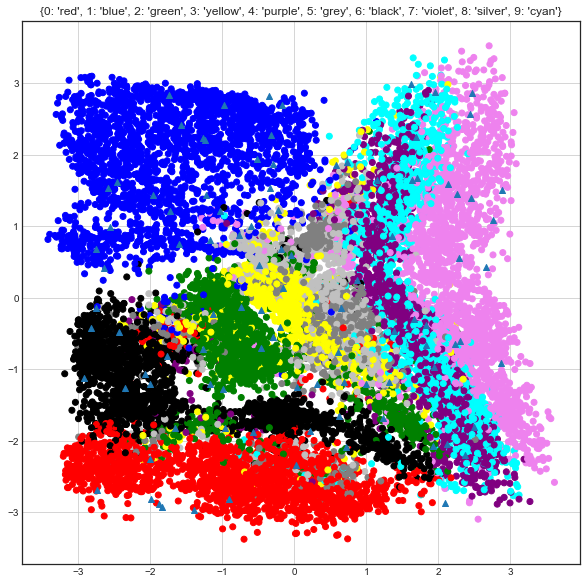

 iter: 85 batch: 19900 recon    cost: 0.15686576 dis one  cost: 0.72642845								 dis zero cost: 0.6202718 fake     cost: 0.888218644

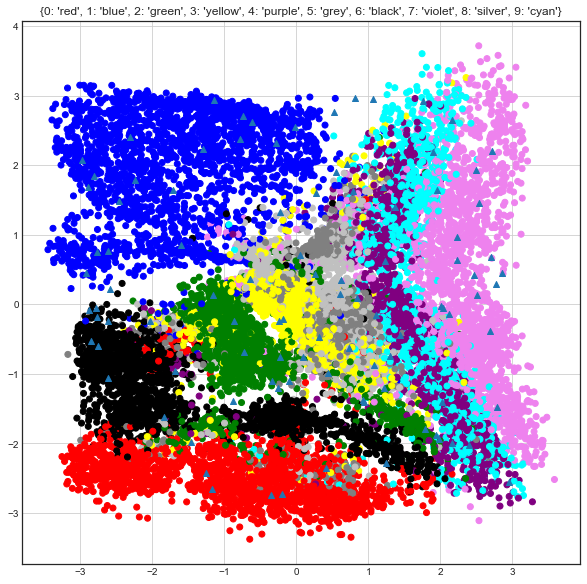

 iter: 86 batch: 19900 recon    cost: 0.15675029 dis one  cost: 0.7409389								 dis zero cost: 0.5383819 fake     cost: 0.8748878836

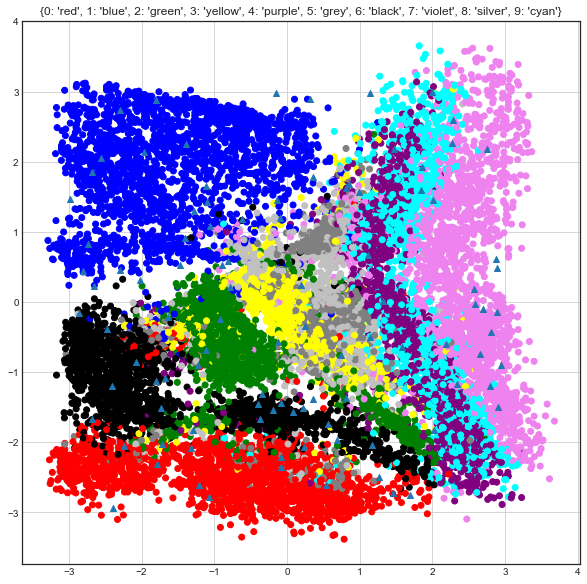

 iter: 87 batch: 19900 recon    cost: 0.15658143 dis one  cost: 0.76118624								 dis zero cost: 0.5802703 fake     cost: 0.815396136

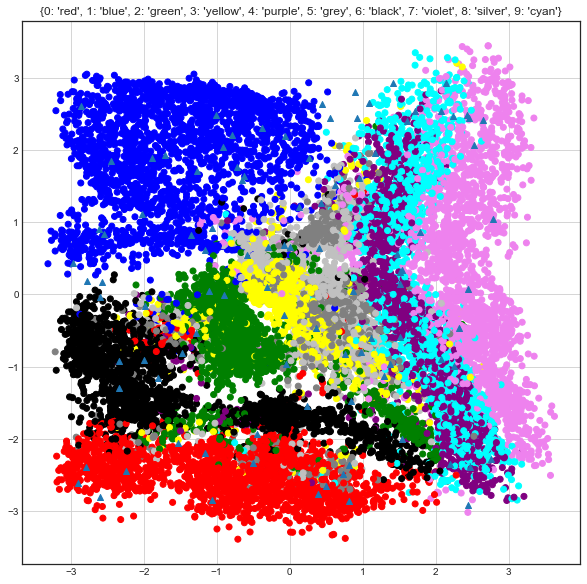

 iter: 88 batch: 19900 recon    cost: 0.15644439 dis one  cost: 0.7127377								 dis zero cost: 0.5964804 fake     cost: 0.9092527667

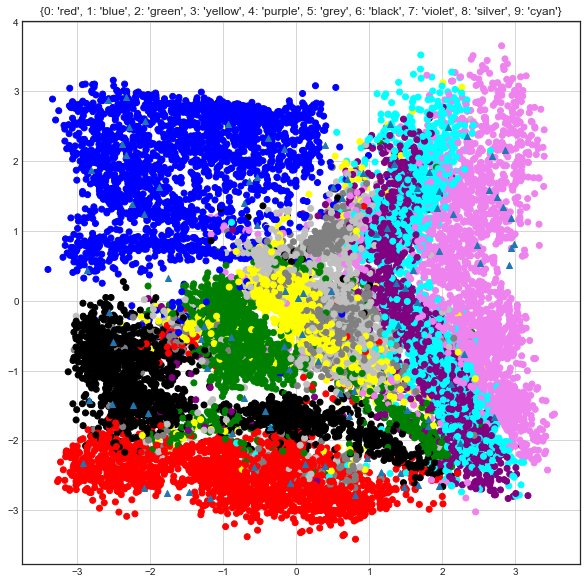

 iter: 89 batch: 19900 recon    cost: 0.15640625 dis one  cost: 0.72413856								 dis zero cost: 0.6679184 fake     cost: 0.988257836

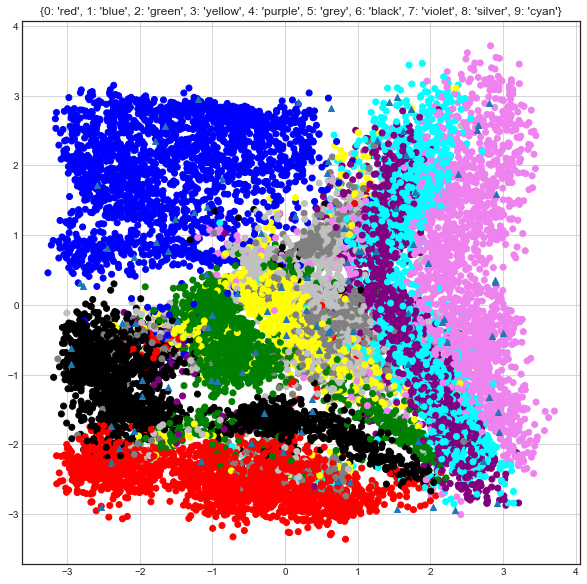

 iter: 90 batch: 19900 recon    cost: 0.1561662 dis one  cost: 0.71604955								 dis zero cost: 0.5817566 fake     cost: 0.8838994573

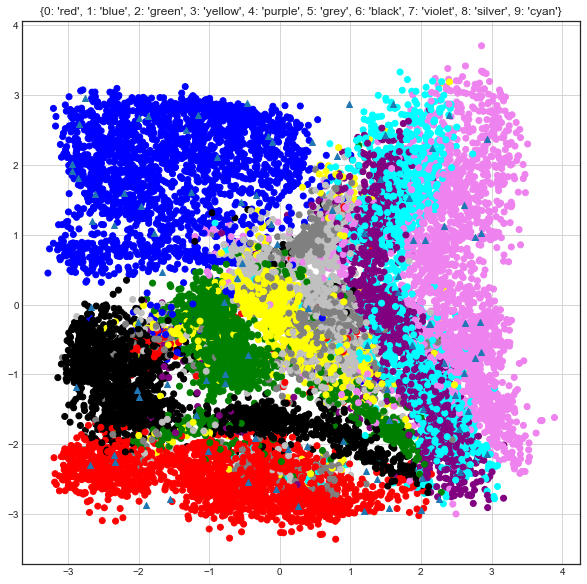

 iter: 91 batch: 19900 recon    cost: 0.15605892 dis one  cost: 0.69674665								 dis zero cost: 0.57513005 fake     cost: 0.98531073

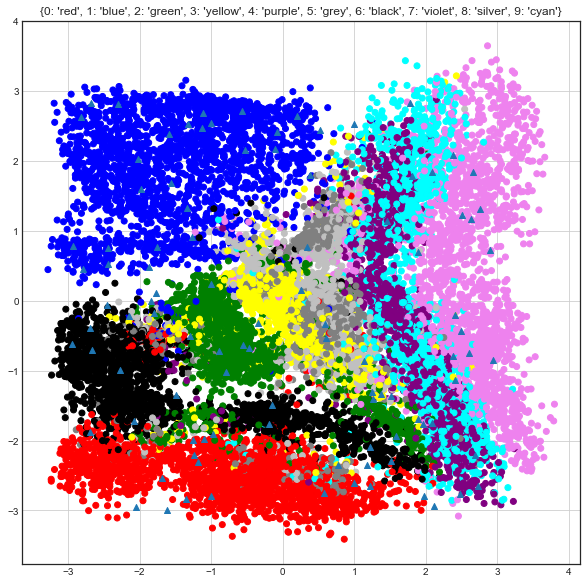

 iter: 92 batch: 19900 recon    cost: 0.15589744 dis one  cost: 0.71204776								 dis zero cost: 0.6162097 fake     cost: 0.917865793

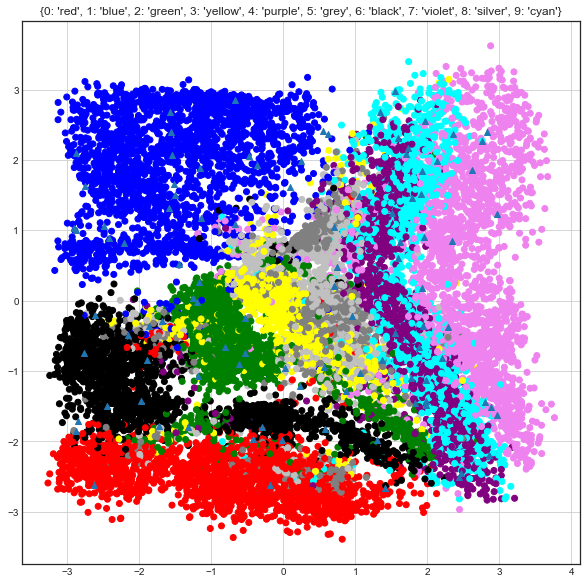

 iter: 93 batch: 19900 recon    cost: 0.15584919 dis one  cost: 0.7262033								 dis zero cost: 0.5722521 fake     cost: 0.9094676486

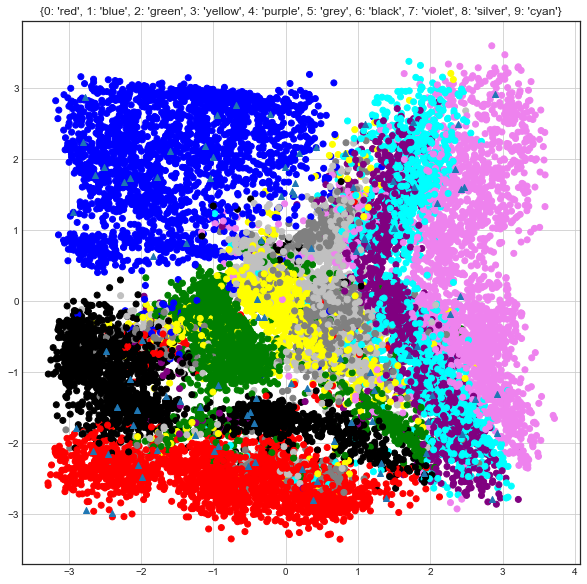

 iter: 94 batch: 19900 recon    cost: 0.15565921 dis one  cost: 0.7174788								 dis zero cost: 0.5571752 fake     cost: 0.8832279417

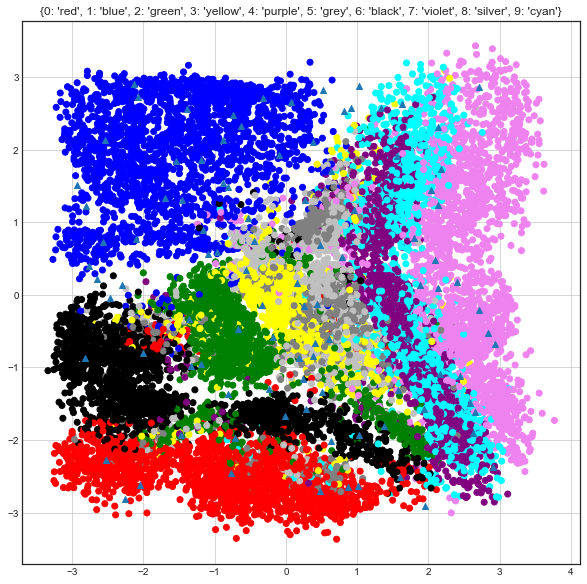

 iter: 95 batch: 19900 recon    cost: 0.15565416 dis one  cost: 0.71686727								 dis zero cost: 0.652007 fake     cost: 0.9196576174

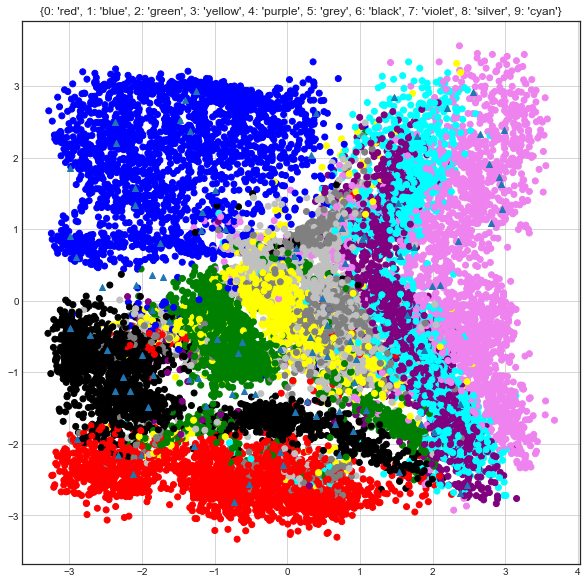

 iter: 96 batch: 19900 recon    cost: 0.15550767 dis one  cost: 0.70876485								 dis zero cost: 0.55717283 fake     cost: 0.87325585

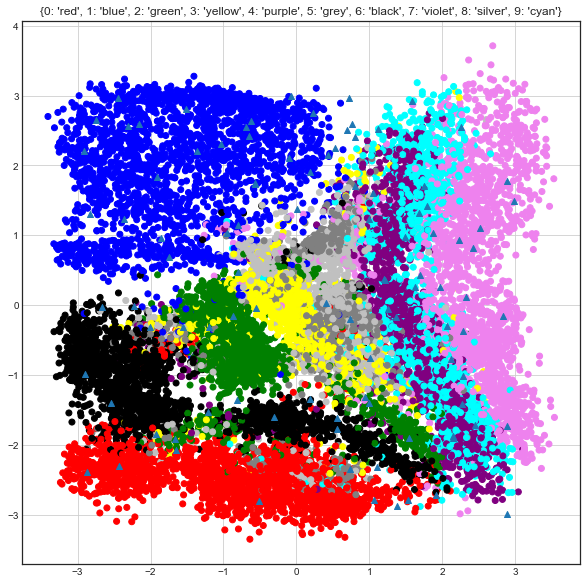

 iter: 97 batch: 19900 recon    cost: 0.15542956 dis one  cost: 0.74057746								 dis zero cost: 0.66824204 fake     cost: 0.82103627

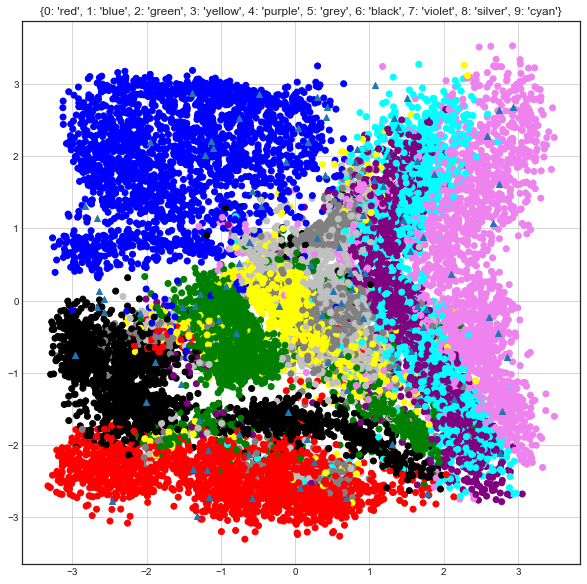

 iter: 98 batch: 19900 recon    cost: 0.15543701 dis one  cost: 0.7216294								 dis zero cost: 0.5604056 fake     cost: 0.8309842474

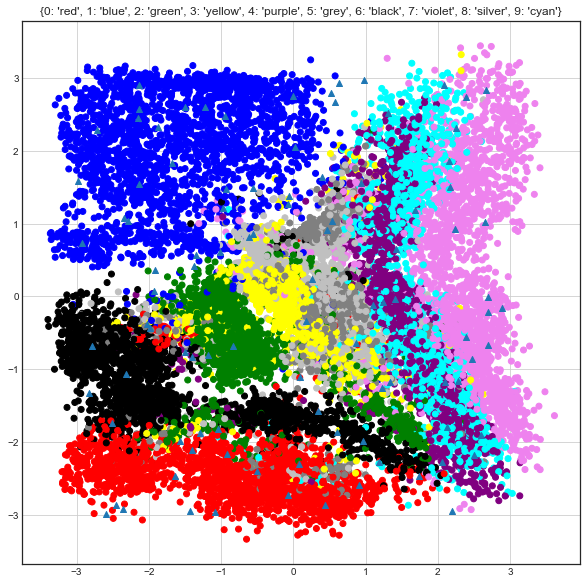

 iter: 99 batch: 19900 recon    cost: 0.15555885 dis one  cost: 0.7549494								 dis zero cost: 0.6350596 fake     cost: 0.8050417415

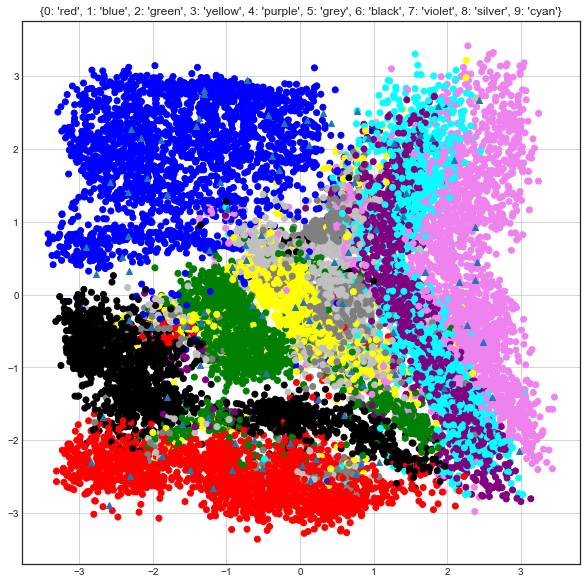

 iter: 100 batch: 19900 recon    cost: 0.15521185 dis one  cost: 0.76031435								 dis zero cost: 0.6553868 fake     cost: 0.796073446

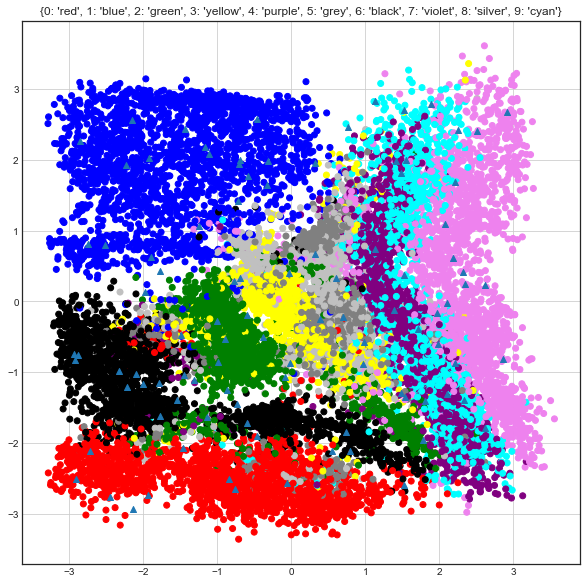

In [81]:
# start the session
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}

for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z      = np.random.uniform(low=-3.0, high=3.0,size=(batch_size, 2)).astype(np.float32)
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.0002
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.002})

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
        
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-15,15);plt.ylim(-15,15);
        plt.grid();plt.show()

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()